<a href="https://colab.research.google.com/github/modeloacessibilidade/ProjetoIntegrador/blob/master/E00_V08_paty_classificacao_v0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **PROJETO INTEGRADOR - GRUPO 03**

***Lucas, Patrícia, Tiago & Victor Wood***


---



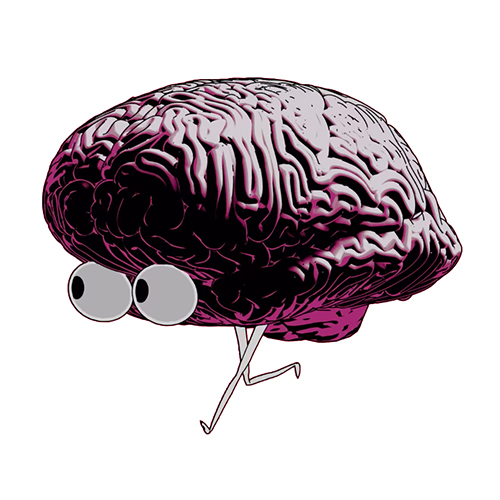

## Documentação datasets Yelp:
https://www.yelp.com/dataset/documentation/faq


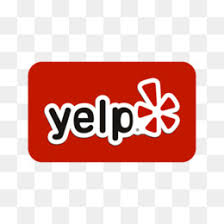


--------------------------------------------------------------------------------

## O Problema de negócio: 
Predizer qual será a nota do estabelecimento levando em consideração os atributos de acessibilidade | facility(espaço para cadeirantes, aceita cachorros, espaço para crianças etc.)

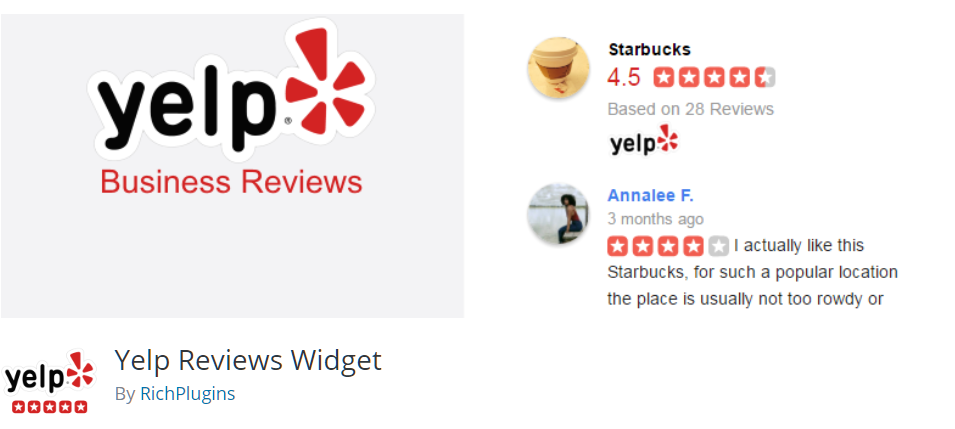

## Estratégias para solução do problema:
 
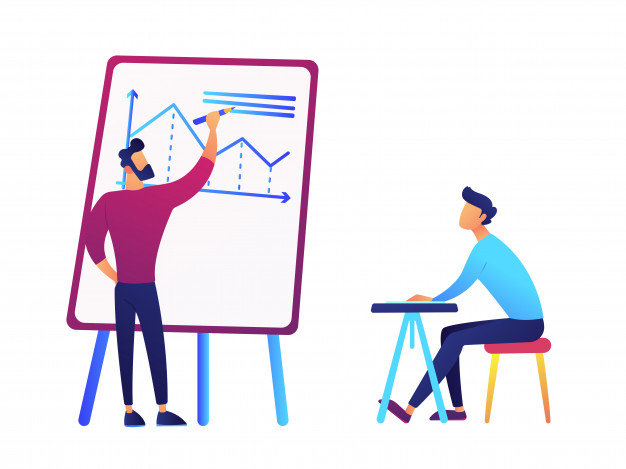






* Avaliar por questões de Acessibilidade: Aceita cartões| Aceita pets| Tem estacionamento etc... 
* Coletar dados nos portais de avaliações dos estabelecimentos para conseguirmos essas informações.
* Analisar os dados coletados.
* Criar um modelo de regressão para prever qual será a nota do usuário, identificando as variáveis que impactam no bom funcionamento de um estabelecimento por região.
* Dados para serem treinados: Região | Acessibilidade| Tipos de estabelecimentos|Avaliações(target).

 
 
 
 
 
 ----------------------------------------------------------------------------------------



## Ciclos
  * Ciclo 00: Coletar os dados nos portais de avaliações
  * Ciclo 01: Analise exploratória inicial dos dados coletados, entender a base
  * Ciclo 02: Limpeza dos dados 
  * Ciclo 03: Analise exploratoria mais aprofundada dos dados
  * Ciclo 04: Escolha das Feature
  * Ciclo 05: Levantar Hipoteses:
      * ---- Quais itens de acessibilidade(aceitar cartão, aceitar pets etc...) tem um maior impacto para um estabelecimento.
      * ----  Qual o impacto desses itens de acessibilidade por região

  * Ciclo 06: Fazer análise e validação dessas hipóteses 
  * Ciclo 07: Preparar os dados para treino e teste
  * Ciclo 08: Aplicar  os algoritmos de Machine learning
  * Ciclo 09: Aplicar métricas de performance do modelo
  * Ciclo 10: Colocar o modelo em produção


  ---------------------------------------------------------------------------------

##Leitura dos datasets e análise exploratória

- Montando Drive no Colab

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


-  Importando as Bibliotecas

In [ ]:
import pandas as pd
import numpy as np
import json
import os
import re
import seaborn as sns
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
import matplotlib.pyplot as plt
import matplotlib.image as mpim
import scipy.stats as st
from scipy import stats
from statsmodels.formula.api  import ols
%matplotlib inline
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, mean_squared_error
from sklearn.linear_model import  LinearRegression
from sklearn.metrics import r2_score
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import StandardScaler
# Essa biblioteca mistura os dados e garante que todos tenham informação
from sklearn.model_selection import StratifiedKFold
from sklearn import preprocessing 
from imblearn.under_sampling import NearMiss

- Importando arquivos json do Drive

In [ ]:
os.chdir("/content/drive/My Drive/Yelp_datasets")
os.listdir()

['yelp_academic_dataset_business.json',
'categories.json']

['yelp_academic_dataset_business.json', 'categories.json']

## DATASETS

**Dataset 1/6 - "CATEGORIES"**

- Criando DataFrame do dataset CATEGORIES

In [ ]:
with open('categories.json') as categories00:
  data= categories00.read()
objeto = json.loads(data)
df_categories = pd.DataFrame(objeto)

In [ ]:
df_categories.head()

,alias,title,parents,country_whitelist,country_blacklist
0,3dprinting,3D Printing,[localservices],NaN,NaN
1,abruzzese,Abruzzese,[italian],[IT],NaN
2,absinthebars,Absinthe Bars,[bars],[CZ],NaN
3,acaibowls,Acai Bowls,[food],NaN,"[AR, TR, IT, PL, MX, CL]"
4,accessories,Accessories,[fashion],NaN,NaN


In [ ]:
df_categories.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1565 entries, 0 to 1564
Data columns (total 5 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   alias              1565 non-null   object
 1   title              1565 non-null   object
 2   parents            1565 non-null   object
 3   country_whitelist  531 non-null    object
 4   country_blacklist  352 non-null    object
dtypes: object(5)
memory usage: 61.3+ KB


In [ ]:
df_categories = df_categories[['title', 'parents']]

In [ ]:
df_categories

,title,parents
0,3D Printing,[localservices]
1,Abruzzese,[italian]
2,Absinthe Bars,[bars]
3,Acai Bowls,[food]
4,Accessories,[fashion]
...,...,...
1560,Yugoslav,[restaurants]
1561,Zapiekanka,[food]
1562,Ziplining,[active]
1563,Zoos,[active]


In [ ]:
# Observando se existem categorias repetidas

print(df_categories.shape)
print(df_categories['title'].unique().shape)

(1565, 2)
(1565,)


**Fazendo limpeza dos dados, extraindo somente as informações texto da coluna parents(eliminando o colchete)**

In [ ]:
parents = df_categories.parents.apply(pd.Series)
parents.head(10)

,0,1,2
0,localservices,NaN,NaN
1,italian,NaN,NaN
2,bars,NaN,NaN
3,food,NaN,NaN
4,fashion,NaN,NaN
5,professional,NaN,NaN
6,beautysvc,NaN,NaN
7,NaN,NaN,NaN
8,health,NaN,NaN
9,physicians,NaN,NaN


- Excluindo as colunas 1 e 2 que são inúteis 

In [ ]:
parents = parents.drop(columns=[1,2])
parents.head()

,0
0,localservices
1,italian
2,bars
3,food
4,fashion


 ###  Renomeando a coluna 0

In [ ]:
parents.columns = ['Parents']
parents.head()

,Parents
0,localservices
1,italian
2,bars
3,food
4,fashion


 **Fazendo a união da tabela parents à tabela mãe df_categorie**

In [ ]:
df_categories = pd.concat([df_categories, parents], axis = 1).drop(columns=['parents'])
df_categories.head(5)

,title,Parents
0,3D Printing,localservices
1,Abruzzese,italian
2,Absinthe Bars,bars
3,Acai Bowls,food
4,Accessories,fashion


In [ ]:
df_categories['title'] = df_categories['title'].replace({' ':''}, regex=True).str.lower()
df_categories['Parents'] = df_categories['Parents'].replace({' ':''}, regex=True).str.lower()
display(df_categories)

,title,Parents
0,3dprinting,localservices
1,abruzzese,italian
2,absinthebars,bars
3,acaibowls,food
4,accessories,fashion
...,...,...
1560,yugoslav,restaurants
1561,zapiekanka,food
1562,ziplining,active
1563,zoos,active


### Criando novas colunas e eliminando as anteriores

In [ ]:
df_categories['categoria_macro'] = df_categories['Parents']
df_categories['categoria_micro'] = df_categories['title']
df_categories = df_categories.drop(columns=['Parents','title'])

In [ ]:
df_categories

,categoria_macro,categoria_micro
0,localservices,3dprinting
1,italian,abruzzese
2,bars,absinthebars
3,food,acaibowls
4,fashion,accessories
...,...,...
1560,restaurants,yugoslav
1561,food,zapiekanka
1562,active,ziplining
1563,active,zoos


In [ ]:
df_categories.loc[df_categories.categoria_micro == 'food']

,categoria_macro,categoria_micro
535,NaN,food


### Analisando os dados nulos da coluna categoria macro 

In [ ]:
df_categories[df_categories['categoria_macro'].isnull()]

,categoria_macro,categoria_micro
7,NaN,activelife
68,NaN,arts&entertainment
87,NaN,automotive
136,NaN,beauty&spas
154,NaN,bicycles
443,NaN,education
483,NaN,eventplanning&services
509,NaN,financialservices
535,NaN,food
642,NaN,health&medical


In [ ]:
df_categories[df_categories['categoria_micro'].isnull()]

,categoria_macro,categoria_micro


In [ ]:
# Substituindo os NaN

df_categories['categoria_macro'][7] = 'active'
df_categories['categoria_macro'][68] = 'arts'
df_categories['categoria_macro'][87] = 'auto'
df_categories['categoria_macro'][136] = 'beautysvc'
df_categories['categoria_macro'][154] = 'bicycles'
df_categories['categoria_macro'][443] = 'education'
df_categories['categoria_macro'][483] = 'eventservices'
df_categories['categoria_macro'][509] = 'financialservices'
df_categories['categoria_macro'][535] = 'food'
df_categories['categoria_macro'][642] = 'health'
df_categories['categoria_macro'][684] = 'homeservices'
df_categories['categoria_macro'][705] = 'hotelstravel'
df_categories['categoria_macro'][825] = 'localflavor'
df_categories['categoria_macro'][826] = 'localservices'
df_categories['categoria_macro'][855] = 'massmedia'
df_categories['categoria_macro'][944] = 'nightlife'
df_categories['categoria_macro'][1058] = 'pets'
df_categories['categoria_macro'][1125] = 'professional'
df_categories['categoria_macro'][1146] = 'publicservicesgovt'
df_categories['categoria_macro'][1179] = 'religiousorgs'
df_categories['categoria_macro'][1186] = 'restaurants'
df_categories['categoria_macro'][1262] = 'shopping'

* Fazendo   a leitura do dataframe

In [ ]:
df_categories

,categoria_macro,categoria_micro
0,localservices,3dprinting
1,italian,abruzzese
2,bars,absinthebars
3,food,acaibowls
4,fashion,accessories
...,...,...
1560,restaurants,yugoslav
1561,food,zapiekanka
1562,active,ziplining
1563,active,zoos


* Verificando os tipos de dados e se tem algum dado faltante

In [ ]:
df_categories.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1565 entries, 0 to 1564
Data columns (total 2 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   categoria_macro  1565 non-null   object
 1   categoria_micro  1565 non-null   object
dtypes: object(2)
memory usage: 24.6+ KB


### Verficando os dados unicos


In [ ]:
df_categories['categoria_macro'].unique().tolist()

['localservices',
 'italian',
 'bars',
 'food',
 'fashion',
 'professional',
 'beautysvc',
 'active',
 'health',
 'physicians',
 'shopping',
 'education',
 'nightlife',
 'fitness',
 'tours',
 'medicalspa',
 'restaurants',
 'religiousorgs',
 'hotels',
 'auto',
 'transport',
 'hotelstravel',
 'airports',
 'portuguese',
 'french',
 'petservices',
 'pets',
 'realestateagents',
 'realestate',
 'homeandgarden',
 'arabian',
 'arts',
 'spanish',
 'homeservices',
 'museums',
 'specialtyschools',
 'artsandcrafts',
 'psychic_astrology',
 'farms',
 'partyequipmentrentals',
 'publicservicesgovt',
 'insurance',
 'plumbing',
 'german',
 'eventservices',
 'lawyers',
 'financialservices',
 'bicycles',
 'sportgoods',
 'petstore',
 'japanese',
 'hair',
 'media',
 'photographers',
 'brazilian',
 'martialarts',
 'breweries',
 'medcenters',
 'gourmet',
 'cannabis_clinics',
 'chinese',
 'autoglass',
 'turkish',
 'tastingclasses',
 'gyms',
 'latin',
 'dentists',
 'legalservices',
 'funeralservices',
 'sportsw

* Criando uma lista de categorias

In [ ]:
lista_categorias_macro = ['italian',
'food',
'restaurants',
'portuguese',
'french',
'arabian',
'spanish',
'german',
'japanese',
'bars',
'chinese',
'brazilian',
'breweries',
'gourmet',
'turkish',
'latin',
'caribbean',
'mexican',
'mideastern',
'mediterranean',
'belgian',
'malaysian',
'jpsweets',
'cafes',
'wineries']

In [ ]:
df_categories.head()

,categoria_macro,categoria_micro
0,localservices,3dprinting
1,italian,abruzzese
2,bars,absinthebars
3,food,acaibowls
4,fashion,accessories


**Dataset 2/6 - "BUSINESS"**\
*Contains business data including location data, attributes, and categories.*

* Criando datraframe do dataset de  Business

In [ ]:
# Criando DataFrame do dataset "BUSINESS"
business = []
with open('yelp_academic_dataset_business.json') as business00:
    for i, line in enumerate(business00):
        business.append(json.loads(line))
df_business = pd.DataFrame(business)

In [ ]:
df_business.head()

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,f9NumwFMBDn751xgFiRbNA,The Range At Lake Norman,10913 Bailey Rd,Cornelius,NC,28031,35.462724,-80.852612,3.5,36,1,"{'BusinessAcceptsCreditCards': 'True', 'BikePa...","Active Life, Gun/Rifle Ranges, Guns & Ammo, Sh...","{'Monday': '10:0-18:0', 'Tuesday': '11:0-20:0'..."
1,Yzvjg0SayhoZgCljUJRF9Q,"Carlos Santo, NMD","8880 E Via Linda, Ste 107",Scottsdale,AZ,85258,33.569404,-111.890264,5.0,4,1,"{'GoodForKids': 'True', 'ByAppointmentOnly': '...","Health & Medical, Fitness & Instruction, Yoga,...",None
2,XNoUzKckATkOD1hP6vghZg,Felinus,3554 Rue Notre-Dame O,Montreal,QC,H4C 1P4,45.479984,-73.580070,5.0,5,1,None,"Pets, Pet Services, Pet Groomers",None
3,6OAZjbxqM5ol29BuHsil3w,Nevada House of Hose,1015 Sharp Cir,North Las Vegas,NV,89030,36.219728,-115.127725,2.5,3,0,"{'BusinessAcceptsCreditCards': 'True', 'ByAppo...","Hardware Stores, Home Services, Building Suppl...","{'Monday': '7:0-16:0', 'Tuesday': '7:0-16:0', ..."
4,51M2Kk903DFYI6gnB5I6SQ,USE MY GUY SERVICES LLC,4827 E Downing Cir,Mesa,AZ,85205,33.428065,-111.726648,4.5,26,1,"{'BusinessAcceptsCreditCards': 'True', 'ByAppo...","Home Services, Plumbing, Electricians, Handyma...","{'Monday': '0:0-0:0', 'Tuesday': '9:0-16:0', '..."


## Descricao do dataframe business

*  "business_id": // string, 22 character unique string business id
* "name": // string, the business's name
* "address": // string, the full address of the business
* "city": // string, the city
* "state": // string, 2 character state code, if applicable
* "postal code": // string, the postal code
* "latitude": // float, latitude
* "longitude": // float, longitude
* "stars": // float, star rating, rounded to half-stars
*  "review_count": // integer, number of reviews
* "is_open": // integer, 0 or 1 for closed or open, respectively
*  "attributes": // object, business attributes to values. note: some attribute values might be objects
* "categories": // an array of strings of business categories
* "hours": // an object of key day to value hours, hours are using a 24hr cloc

Criando uma nova variavel

In [ ]:
df_business_teste = df_business

* Transformando a primeira letra dos dados da coluna categories de Maiuscula para  letra minuscula

In [ ]:
df_business_teste['categories'] = df_business_teste['categories'].replace({' ':''}, regex=True).str.lower()
df_business_teste.head()

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,f9NumwFMBDn751xgFiRbNA,The Range At Lake Norman,10913 Bailey Rd,Cornelius,NC,28031,35.462724,-80.852612,3.5,36,1,"{'BusinessAcceptsCreditCards': 'True', 'BikePa...","activelife,gun/rifleranges,guns&ammo,shopping","{'Monday': '10:0-18:0', 'Tuesday': '11:0-20:0'..."
1,Yzvjg0SayhoZgCljUJRF9Q,"Carlos Santo, NMD","8880 E Via Linda, Ste 107",Scottsdale,AZ,85258,33.569404,-111.890264,5.0,4,1,"{'GoodForKids': 'True', 'ByAppointmentOnly': '...","health&medical,fitness&instruction,yoga,active...",None
2,XNoUzKckATkOD1hP6vghZg,Felinus,3554 Rue Notre-Dame O,Montreal,QC,H4C 1P4,45.479984,-73.580070,5.0,5,1,None,"pets,petservices,petgroomers",None
3,6OAZjbxqM5ol29BuHsil3w,Nevada House of Hose,1015 Sharp Cir,North Las Vegas,NV,89030,36.219728,-115.127725,2.5,3,0,"{'BusinessAcceptsCreditCards': 'True', 'ByAppo...","hardwarestores,homeservices,buildingsupplies,h...","{'Monday': '7:0-16:0', 'Tuesday': '7:0-16:0', ..."
4,51M2Kk903DFYI6gnB5I6SQ,USE MY GUY SERVICES LLC,4827 E Downing Cir,Mesa,AZ,85205,33.428065,-111.726648,4.5,26,1,"{'BusinessAcceptsCreditCards': 'True', 'ByAppo...","homeservices,plumbing,electricians,handyman,co...","{'Monday': '0:0-0:0', 'Tuesday': '9:0-16:0', '..."


* Criando um novo dataframe recebendo as informacoes do dataframe anterior, mas inserindo uma nova coluna categories_micro para desmembrar o dicionario  da coluna categories(separando as categorias)


In [ ]:
df_business_teste2 = pd.DataFrame(df_business_teste.assign(categoria_micro=df_business_teste['categories'].str.split(',')).explode('categoria_micro'))

In [ ]:
df_business_teste2

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours,categoria_micro
0,f9NumwFMBDn751xgFiRbNA,The Range At Lake Norman,10913 Bailey Rd,Cornelius,NC,28031,35.462724,-80.852612,3.5,36,1,"{'BusinessAcceptsCreditCards': 'True', 'BikePa...","activelife,gun/rifleranges,guns&ammo,shopping","{'Monday': '10:0-18:0', 'Tuesday': '11:0-20:0'...",activelife
0,f9NumwFMBDn751xgFiRbNA,The Range At Lake Norman,10913 Bailey Rd,Cornelius,NC,28031,35.462724,-80.852612,3.5,36,1,"{'BusinessAcceptsCreditCards': 'True', 'BikePa...","activelife,gun/rifleranges,guns&ammo,shopping","{'Monday': '10:0-18:0', 'Tuesday': '11:0-20:0'...",gun/rifleranges
0,f9NumwFMBDn751xgFiRbNA,The Range At Lake Norman,10913 Bailey Rd,Cornelius,NC,28031,35.462724,-80.852612,3.5,36,1,"{'BusinessAcceptsCreditCards': 'True', 'BikePa...","activelife,gun/rifleranges,guns&ammo,shopping","{'Monday': '10:0-18:0', 'Tuesday': '11:0-20:0'...",guns&ammo
0,f9NumwFMBDn751xgFiRbNA,The Range At Lake Norman,10913 Bailey Rd,Cornelius,NC,28031,35.462724,-80.852612,3.5,36,1,"{'BusinessAcceptsCreditCards': 'True', 'BikePa...","activelife,gun/rifleranges,guns&ammo,shopping","{'Monday': '10:0-18:0', 'Tuesday': '11:0-20:0'...",shopping
1,Yzvjg0SayhoZgCljUJRF9Q,"Carlos Santo, NMD","8880 E Via Linda, Ste 107",Scottsdale,AZ,85258,33.569404,-111.890264,5.0,4,1,"{'GoodForKids': 'True', 'ByAppointmentOnly': '...","health&medical,fitness&instruction,yoga,active...",None,health&medical
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
209391,RSSIsgO00OuWQTRoITacpA,Indian Trail Dog Training,,Indian Trail,NC,28079,35.101965,-80.599385,5.0,3,1,None,"petservices,pettraining,pets","{'Monday': '0:0-0:0', 'Tuesday': '7:0-19:0', '...",pets
209392,tOcYmewXFhQeZh3V42ymwg,Kudlow Ye,"21 St Clair Avenue E, Suite 401",Toronto,ON,M4T 1L9,43.688214,-79.392756,5.0,3,1,None,"taxservices,professionalservices,accountants,f...","{'Monday': '9:0-18:0', 'Tuesday': '9:0-18:0', ...",taxservices
209392,tOcYmewXFhQeZh3V42ymwg,Kudlow Ye,"21 St Clair Avenue E, Suite 401",Toronto,ON,M4T 1L9,43.688214,-79.392756,5.0,3,1,None,"taxservices,professionalservices,accountants,f...","{'Monday': '9:0-18:0', 'Tuesday': '9:0-18:0', ...",professionalservices
209392,tOcYmewXFhQeZh3V42ymwg,Kudlow Ye,"21 St Clair Avenue E, Suite 401",Toronto,ON,M4T 1L9,43.688214,-79.392756,5.0,3,1,None,"taxservices,professionalservices,accountants,f...","{'Monday': '9:0-18:0', 'Tuesday': '9:0-18:0', ...",accountants


*  Concatenando as informacoes da variavel df_ categories(coluna categoria_macr) a variavel df_business_teste2

In [ ]:
df_business_teste2 = df_business_teste2.merge(df_categories, on = 'categoria_micro', how = 'left')
df_business_teste2

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours,categoria_micro,categoria_macro
0,f9NumwFMBDn751xgFiRbNA,The Range At Lake Norman,10913 Bailey Rd,Cornelius,NC,28031,35.462724,-80.852612,3.5,36,1,"{'BusinessAcceptsCreditCards': 'True', 'BikePa...","activelife,gun/rifleranges,guns&ammo,shopping","{'Monday': '10:0-18:0', 'Tuesday': '11:0-20:0'...",activelife,active
1,f9NumwFMBDn751xgFiRbNA,The Range At Lake Norman,10913 Bailey Rd,Cornelius,NC,28031,35.462724,-80.852612,3.5,36,1,"{'BusinessAcceptsCreditCards': 'True', 'BikePa...","activelife,gun/rifleranges,guns&ammo,shopping","{'Monday': '10:0-18:0', 'Tuesday': '11:0-20:0'...",gun/rifleranges,active
2,f9NumwFMBDn751xgFiRbNA,The Range At Lake Norman,10913 Bailey Rd,Cornelius,NC,28031,35.462724,-80.852612,3.5,36,1,"{'BusinessAcceptsCreditCards': 'True', 'BikePa...","activelife,gun/rifleranges,guns&ammo,shopping","{'Monday': '10:0-18:0', 'Tuesday': '11:0-20:0'...",guns&ammo,shopping
3,f9NumwFMBDn751xgFiRbNA,The Range At Lake Norman,10913 Bailey Rd,Cornelius,NC,28031,35.462724,-80.852612,3.5,36,1,"{'BusinessAcceptsCreditCards': 'True', 'BikePa...","activelife,gun/rifleranges,guns&ammo,shopping","{'Monday': '10:0-18:0', 'Tuesday': '11:0-20:0'...",shopping,shopping
4,Yzvjg0SayhoZgCljUJRF9Q,"Carlos Santo, NMD","8880 E Via Linda, Ste 107",Scottsdale,AZ,85258,33.569404,-111.890264,5.0,4,1,"{'GoodForKids': 'True', 'ByAppointmentOnly': '...","health&medical,fitness&instruction,yoga,active...",None,health&medical,health
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
873313,RSSIsgO00OuWQTRoITacpA,Indian Trail Dog Training,,Indian Trail,NC,28079,35.101965,-80.599385,5.0,3,1,None,"petservices,pettraining,pets","{'Monday': '0:0-0:0', 'Tuesday': '7:0-19:0', '...",pets,pets
873314,tOcYmewXFhQeZh3V42ymwg,Kudlow Ye,"21 St Clair Avenue E, Suite 401",Toronto,ON,M4T 1L9,43.688214,-79.392756,5.0,3,1,None,"taxservices,professionalservices,accountants,f...","{'Monday': '9:0-18:0', 'Tuesday': '9:0-18:0', ...",taxservices,financialservices
873315,tOcYmewXFhQeZh3V42ymwg,Kudlow Ye,"21 St Clair Avenue E, Suite 401",Toronto,ON,M4T 1L9,43.688214,-79.392756,5.0,3,1,None,"taxservices,professionalservices,accountants,f...","{'Monday': '9:0-18:0', 'Tuesday': '9:0-18:0', ...",professionalservices,professional
873316,tOcYmewXFhQeZh3V42ymwg,Kudlow Ye,"21 St Clair Avenue E, Suite 401",Toronto,ON,M4T 1L9,43.688214,-79.392756,5.0,3,1,None,"taxservices,professionalservices,accountants,f...","{'Monday': '9:0-18:0', 'Tuesday': '9:0-18:0', ...",accountants,professional


* analisando que tipo de  colunas nos temos na variavel df_business_teste2 





In [ ]:
df_business_teste2.columns

Index(['business_id', 'name', 'address', 'city', 'state', 'postal_code',
       'latitude', 'longitude', 'stars', 'review_count', 'is_open',
       'attributes', 'categories', 'hours', 'categoria_micro',
       'categoria_macro'],
      dtype='object')

* Eliminando a coluna categories, como  foi desmenbrada em uma nova coluna nao tem mais sentido manter essa coluna

In [ ]:
df_business_teste2 = df_business_teste2.drop(columns = ['categories'])

* Verificando novamente as colunas

In [ ]:
df_business_teste2.columns

Index(['business_id', 'name', 'address', 'city', 'state', 'postal_code',
       'latitude', 'longitude', 'stars', 'review_count', 'is_open',
       'attributes', 'hours', 'categoria_micro', 'categoria_macro'],
      dtype='object')

In [ ]:
df_business_teste3 = df_business_teste2[df_business_teste2['categoria_macro'].isin(lista_categorias_macro)].reset_index()

In [ ]:
df_business_teste3

,index,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,hours,categoria_micro,categoria_macro
0,34,pQeaRpvuhoEqudo3uymHIQ,The Empanadas House,404 E Green St,Champaign,IL,61820,40.110446,-88.233073,4.5,5,1,"{'RestaurantsAttire': 'u'casual'', 'Restaurant...","{'Monday': '11:30-14:30', 'Tuesday': '11:30-14...",foodtrucks,food
1,35,pQeaRpvuhoEqudo3uymHIQ,The Empanadas House,404 E Green St,Champaign,IL,61820,40.110446,-88.233073,4.5,5,1,"{'RestaurantsAttire': 'u'casual'', 'Restaurant...","{'Monday': '11:30-14:30', 'Tuesday': '11:30-14...",specialtyfood,food
2,36,pQeaRpvuhoEqudo3uymHIQ,The Empanadas House,404 E Green St,Champaign,IL,61820,40.110446,-88.233073,4.5,5,1,"{'RestaurantsAttire': 'u'casual'', 'Restaurant...","{'Monday': '11:30-14:30', 'Tuesday': '11:30-14...",importedfood,food
3,37,pQeaRpvuhoEqudo3uymHIQ,The Empanadas House,404 E Green St,Champaign,IL,61820,40.110446,-88.233073,4.5,5,1,"{'RestaurantsAttire': 'u'casual'', 'Restaurant...","{'Monday': '11:30-14:30', 'Tuesday': '11:30-14...",argentine,restaurants
4,38,pQeaRpvuhoEqudo3uymHIQ,The Empanadas House,404 E Green St,Champaign,IL,61820,40.110446,-88.233073,4.5,5,1,"{'RestaurantsAttire': 'u'casual'', 'Restaurant...","{'Monday': '11:30-14:30', 'Tuesday': '11:30-14...",food,food
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284434,873306,SYa2j1boLF8DcGVOYfHPcA,Five Guys,7014-590 E Camelback Rd,Scottsdale,AZ,85251,33.504062,-111.929431,3.5,97,1,"{'BusinessAcceptsCreditCards': 'True', 'Restau...","{'Monday': '11:0-22:0', 'Tuesday': '11:0-22:0'...",american(new),restaurants
284435,873307,SYa2j1boLF8DcGVOYfHPcA,Five Guys,7014-590 E Camelback Rd,Scottsdale,AZ,85251,33.504062,-111.929431,3.5,97,1,"{'BusinessAcceptsCreditCards': 'True', 'Restau...","{'Monday': '11:0-22:0', 'Tuesday': '11:0-22:0'...",food,food
284436,873308,SYa2j1boLF8DcGVOYfHPcA,Five Guys,7014-590 E Camelback Rd,Scottsdale,AZ,85251,33.504062,-111.929431,3.5,97,1,"{'BusinessAcceptsCreditCards': 'True', 'Restau...","{'Monday': '11:0-22:0', 'Tuesday': '11:0-22:0'...",burgers,restaurants
284437,873309,SYa2j1boLF8DcGVOYfHPcA,Five Guys,7014-590 E Camelback Rd,Scottsdale,AZ,85251,33.504062,-111.929431,3.5,97,1,"{'BusinessAcceptsCreditCards': 'True', 'Restau...","{'Monday': '11:0-22:0', 'Tuesday': '11:0-22:0'...",restaurants,restaurants


* Fazendo um pivot_table para mensurar a quantidade  de categoria de estabelecimentos avaliado por usuario

In [ ]:
df_business_teste4 = pd.pivot_table(df_business_teste3, values='index', index=['business_id'],
                    columns=['categoria_macro'], aggfunc='count', fill_value=0).reset_index()

In [ ]:
df_business_teste4

categoria_macro,business_id,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries
0,--1UhMGODdWsrMastO9DZw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0
1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0
2,--7zmmkVg-IMGaXbuVd0SQ,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0
3,--9e1ONYQuAa-CB_Rrw7Tw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0
4,--DaPTJW3-tB1vP-PfdTEg,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
82649,zzvlwkcNR1CCqOPXwuvz2A,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,4,0
82650,zzwaS0xn1MVEPEf0hNLjew,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
82651,zzwhN7x37nyjP0ZM8oiHmw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0
82652,zzwicjPC9g246MK2M1ZFBA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6,0


* Verificando a quantidade de avalicoes total por  categoria

In [ ]:
df_business_test = pd.pivot_table(df_business_teste3, values='index',
                    columns=['categoria_macro'], aggfunc='count', fill_value=0).reset_index()

In [ ]:
df_business_test

categoria_macro,index,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries
0,index,11324,120,36,78,649,76468,4,3618,10,415,180,159,863,306,1,190143,65


* Criando uma nova variavel que recebe a variavel  df_business_teste4 concatenada com a df_business_teste

In [ ]:
df_business_teste5 = df_business_teste4.merge(df_business_teste, on = 'business_id', how='left')


In [ ]:
df_business_teste5.head()

,business_id,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,--1UhMGODdWsrMastO9DZw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,The Spicy Amigos,821 4 Avenue SW,Calgary,AB,T2P 0K5,51.049673,-114.079977,4.0,27,1,"{'RestaurantsAttire': 'u'casual'', 'GoodForMea...","restaurants,mexican","{'Monday': '11:0-20:0', 'Tuesday': '11:0-20:0'..."
1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...","chinese,restaurants","{'Monday': '11:0-22:30', 'Tuesday': '11:0-22:3..."
2,--7zmmkVg-IMGaXbuVd0SQ,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,Primal Brewery,16432 Old Statesville Rd,Huntersville,NC,28078,35.437106,-80.843688,4.0,65,1,"{'BusinessAcceptsCreditCards': 'True', 'Caters...","breweries,food","{'Monday': '16:0-22:0', 'Tuesday': '16:0-22:0'..."
3,--9e1ONYQuAa-CB_Rrw7Tw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,Delmonico Steakhouse,3355 Las Vegas Blvd S,Las Vegas,NV,89109,36.123183,-115.169190,4.0,1759,1,"{'Alcohol': ''full_bar'', 'BusinessParking': '...","seafood,cajun/creole,restaurants,steakhouses","{'Monday': '17:0-22:0', 'Tuesday': '17:0-22:0'..."
4,--DaPTJW3-tB1vP-PfdTEg,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Sunnyside Grill,1218 Saint Clair Avenue W,Toronto,ON,M6E,43.677807,-79.444674,4.0,51,1,"{'RestaurantsReservations': 'False', 'NoiseLev...","restaurants,breakfast&brunch","{'Monday': '7:0-15:0', 'Tuesday': '7:0-15:0', ..."


In [ ]:
df_business_teste5.columns

Index(['business_id', 'bars', 'breweries', 'cafes', 'caribbean', 'chinese',
       'food', 'french', 'gourmet', 'italian', 'japanese', 'latin',
       'mediterranean', 'mexican', 'mideastern', 'portuguese', 'restaurants',
       'wineries', 'name', 'address', 'city', 'state', 'postal_code',
       'latitude', 'longitude', 'stars', 'review_count', 'is_open',
       'attributes', 'categories', 'hours'],
      dtype='object')

* Eliminando a coluna categories por nao ter utilidade

In [ ]:
df_business_teste5 = df_business_teste5.drop(columns=['categories'])
df_business_teste5.head()
# ESTÁ BOM ATÉ AQUI

,business_id,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,hours
0,--1UhMGODdWsrMastO9DZw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,The Spicy Amigos,821 4 Avenue SW,Calgary,AB,T2P 0K5,51.049673,-114.079977,4.0,27,1,"{'RestaurantsAttire': 'u'casual'', 'GoodForMea...","{'Monday': '11:0-20:0', 'Tuesday': '11:0-20:0'..."
1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...","{'Monday': '11:0-22:30', 'Tuesday': '11:0-22:3..."
2,--7zmmkVg-IMGaXbuVd0SQ,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,Primal Brewery,16432 Old Statesville Rd,Huntersville,NC,28078,35.437106,-80.843688,4.0,65,1,"{'BusinessAcceptsCreditCards': 'True', 'Caters...","{'Monday': '16:0-22:0', 'Tuesday': '16:0-22:0'..."
3,--9e1ONYQuAa-CB_Rrw7Tw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,Delmonico Steakhouse,3355 Las Vegas Blvd S,Las Vegas,NV,89109,36.123183,-115.169190,4.0,1759,1,"{'Alcohol': ''full_bar'', 'BusinessParking': '...","{'Monday': '17:0-22:0', 'Tuesday': '17:0-22:0'..."
4,--DaPTJW3-tB1vP-PfdTEg,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Sunnyside Grill,1218 Saint Clair Avenue W,Toronto,ON,M6E,43.677807,-79.444674,4.0,51,1,"{'RestaurantsReservations': 'False', 'NoiseLev...","{'Monday': '7:0-15:0', 'Tuesday': '7:0-15:0', ..."


In [ ]:
df_business_teste5.shape

(82654, 30)

 * Desmembrando o dicionario da coluna hours

In [ ]:
df_hours = df_business_teste5['hours'].apply(pd.Series)
df_hours

,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday
0,11:0-20:0,11:0-20:0,11:0-20:0,11:0-20:0,11:0-22:0,12:0-22:0,NaN
1,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30
2,16:0-22:0,16:0-22:0,14:0-22:0,14:0-22:0,12:0-23:0,12:0-23:0,12:0-20:0
3,17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:30,17:0-22:30,17:0-22:0
4,7:0-15:0,7:0-15:0,7:0-15:0,7:0-15:0,7:0-16:0,7:0-16:0,7:0-16:0
...,...,...,...,...,...,...,...
82649,11:30-22:0,11:30-22:0,11:30-22:0,11:30-22:0,11:30-22:30,11:30-22:0,11:30-22:0
82650,15:0-2:0,15:0-2:0,15:0-2:0,19:0-2:0,15:0-2:0,15:0-2:0,15:0-2:0
82651,11:0-0:0,11:0-0:0,11:0-0:0,11:0-0:0,11:0-1:0,11:0-1:0,12:0-22:0
82652,11:0-21:0,11:0-21:0,11:0-21:0,11:0-21:0,11:0-22:0,11:0-22:0,11:0-21:0


* Criando uma variavel nova recebendo a concatenacao da variavel anterior a variavel df_business_teste5

In [ ]:
df_business_teste6 = pd.concat([df_business_teste5, df_hours], axis = 1).reset_index()
df_business_teste6.head()

,index,business_id,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,hours,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday
0,0,--1UhMGODdWsrMastO9DZw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,The Spicy Amigos,821 4 Avenue SW,Calgary,AB,T2P 0K5,51.049673,-114.079977,4.0,27,1,"{'RestaurantsAttire': 'u'casual'', 'GoodForMea...","{'Monday': '11:0-20:0', 'Tuesday': '11:0-20:0'...",11:0-20:0,11:0-20:0,11:0-20:0,11:0-20:0,11:0-22:0,12:0-22:0,NaN
1,1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...","{'Monday': '11:0-22:30', 'Tuesday': '11:0-22:3...",11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30
2,2,--7zmmkVg-IMGaXbuVd0SQ,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,Primal Brewery,16432 Old Statesville Rd,Huntersville,NC,28078,35.437106,-80.843688,4.0,65,1,"{'BusinessAcceptsCreditCards': 'True', 'Caters...","{'Monday': '16:0-22:0', 'Tuesday': '16:0-22:0'...",16:0-22:0,16:0-22:0,14:0-22:0,14:0-22:0,12:0-23:0,12:0-23:0,12:0-20:0
3,3,--9e1ONYQuAa-CB_Rrw7Tw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,Delmonico Steakhouse,3355 Las Vegas Blvd S,Las Vegas,NV,89109,36.123183,-115.169190,4.0,1759,1,"{'Alcohol': ''full_bar'', 'BusinessParking': '...","{'Monday': '17:0-22:0', 'Tuesday': '17:0-22:0'...",17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:30,17:0-22:30,17:0-22:0
4,4,--DaPTJW3-tB1vP-PfdTEg,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Sunnyside Grill,1218 Saint Clair Avenue W,Toronto,ON,M6E,43.677807,-79.444674,4.0,51,1,"{'RestaurantsReservations': 'False', 'NoiseLev...","{'Monday': '7:0-15:0', 'Tuesday': '7:0-15:0', ...",7:0-15:0,7:0-15:0,7:0-15:0,7:0-15:0,7:0-16:0,7:0-16:0,7:0-16:0


* Excluindo a coluna hours que nao e mais necessaria

In [ ]:
df_business_teste6 = df_business_teste6.drop(columns=['hours'])

In [ ]:
df_business_teste6.head()

,index,business_id,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday
0,0,--1UhMGODdWsrMastO9DZw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,The Spicy Amigos,821 4 Avenue SW,Calgary,AB,T2P 0K5,51.049673,-114.079977,4.0,27,1,"{'RestaurantsAttire': 'u'casual'', 'GoodForMea...",11:0-20:0,11:0-20:0,11:0-20:0,11:0-20:0,11:0-22:0,12:0-22:0,NaN
1,1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...",11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30
2,2,--7zmmkVg-IMGaXbuVd0SQ,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,Primal Brewery,16432 Old Statesville Rd,Huntersville,NC,28078,35.437106,-80.843688,4.0,65,1,"{'BusinessAcceptsCreditCards': 'True', 'Caters...",16:0-22:0,16:0-22:0,14:0-22:0,14:0-22:0,12:0-23:0,12:0-23:0,12:0-20:0
3,3,--9e1ONYQuAa-CB_Rrw7Tw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,Delmonico Steakhouse,3355 Las Vegas Blvd S,Las Vegas,NV,89109,36.123183,-115.169190,4.0,1759,1,"{'Alcohol': ''full_bar'', 'BusinessParking': '...",17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:30,17:0-22:30,17:0-22:0
4,4,--DaPTJW3-tB1vP-PfdTEg,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Sunnyside Grill,1218 Saint Clair Avenue W,Toronto,ON,M6E,43.677807,-79.444674,4.0,51,1,"{'RestaurantsReservations': 'False', 'NoiseLev...",7:0-15:0,7:0-15:0,7:0-15:0,7:0-15:0,7:0-16:0,7:0-16:0,7:0-16:0


 * Desmembrando o dicionario da coluna attributes





In [ ]:
df_attributes = df_business_teste6['attributes'].apply(pd.Series)
df_attributes.shape

(82654, 39)

* Criando uma nova variavel para receber a concatenacao da varivel anterior a variavel df_business_teste6

In [ ]:
df_business_teste7 = pd.concat([df_business_teste6, df_attributes], axis = 1)
df_business_teste7.head()

,index,business_id,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,RestaurantsAttire,GoodForMeal,NoiseLevel,BusinessParking,OutdoorSeating,GoodForKids,RestaurantsTableService,Caters,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsTakeOut,Alcohol,RestaurantsDelivery,WiFi,BikeParking,RestaurantsReservations,HasTV,Ambience,BusinessAcceptsCreditCards,WheelchairAccessible,ByAppointmentOnly,HappyHour,BYOBCorkage,Corkage,DogsAllowed,BestNights,Music,CoatCheck,Smoking,GoodForDancing,BusinessAcceptsBitcoin,DriveThru,DietaryRestrictions,BYOB,AcceptsInsurance,AgesAllowed,HairSpecializesIn,Open24Hours,RestaurantsCounterService
0,0,--1UhMGODdWsrMastO9DZw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,The Spicy Amigos,821 4 Avenue SW,Calgary,AB,T2P 0K5,51.049673,-114.079977,4.0,27,1,"{'RestaurantsAttire': 'u'casual'', 'GoodForMea...",11:0-20:0,11:0-20:0,11:0-20:0,11:0-20:0,11:0-22:0,12:0-22:0,NaN,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",u'quiet',"{'garage': False, 'street': False, 'validated'...",True,True,False,None,True,2,True,u'beer_and_wine',False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...",11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",'average',"{'garage': False, 'street': False, 'validated'...",False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,"{'romantic': False, 'intimate': False, 'classy...",True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,--7zmmkVg-IMGaXbuVd0SQ,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,Primal Brewery,16432 Old Statesville Rd,Huntersville,NC,28078,35.437106,-80.843688,4.0,65,1,"{'BusinessAcceptsCreditCards': 'True', 'Caters...",16:0-22:0,16:0-22:0,14:0-22:0,14:0-22:0,12:0-23:0,12:0-23:0,12:0-20:0,NaN,NaN,NaN,"{'garage': True, 'street': False, 'validated':...",NaN,NaN,NaN,False,NaN,1,True,NaN,NaN,NaN,True,NaN,NaN,NaN,True,True,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,--9e1ONYQuAa-CB_Rrw7Tw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,Delmonico Steakhouse,3355 Las Vegas Blvd S,Las Vegas,NV,89109,36.123183,-115.169190,4.0,1759,1,"{'Alcohol': ''full_bar'', 'BusinessParking': '...",17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:30,17:0-22:30,17:0-22:0,'dressy',"{'dessert': False, 'latenight': False, 'lunch'...",u'average',"{'garage': True, 'street': False, 'validated':...",False,False,NaN,False,True,4,False,'full_bar',False,u'no',False,True,True,"{'romantic': False, 'intimate': False, 'classy...",True,NaN,NaN,False,'yes_corkage',True,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,--DaPTJW3-tB1vP-PfdTEg,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Sunnyside Grill,1218 Saint Clair Avenue W,Toronto,ON,M6E,43.677807,-79.444674,4.0,51,1,"{'RestaurantsReservations': 'False', 'NoiseLev...",7:0-15:0,7:0-15:0,7:0-15:0,7:0-15:0,7:0-16:0,7:0-16:0,7:0-16:0,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",u'quiet',"{'garage': False, 'street': True, 'validated':...",False,True,NaN,True,True,2,True,u'none',False,u'free',True,False,True,"{'romantic': False, 'intimate': False, 'classy...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


 * Desmembrando o dicionario da coluna ambience





In [ ]:
df_ambience = pd.DataFrame(df_business_teste7.assign(Ambience=df_business_teste7['Ambience'].str.split(',')).explode('Ambience'))

In [ ]:
df_ambience.head()

,index,business_id,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,RestaurantsAttire,GoodForMeal,NoiseLevel,BusinessParking,OutdoorSeating,GoodForKids,RestaurantsTableService,Caters,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsTakeOut,Alcohol,RestaurantsDelivery,WiFi,BikeParking,RestaurantsReservations,HasTV,Ambience,BusinessAcceptsCreditCards,WheelchairAccessible,ByAppointmentOnly,HappyHour,BYOBCorkage,Corkage,DogsAllowed,BestNights,Music,CoatCheck,Smoking,GoodForDancing,BusinessAcceptsBitcoin,DriveThru,DietaryRestrictions,BYOB,AcceptsInsurance,AgesAllowed,HairSpecializesIn,Open24Hours,RestaurantsCounterService
0,0,--1UhMGODdWsrMastO9DZw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,The Spicy Amigos,821 4 Avenue SW,Calgary,AB,T2P 0K5,51.049673,-114.079977,4.0,27,1,"{'RestaurantsAttire': 'u'casual'', 'GoodForMea...",11:0-20:0,11:0-20:0,11:0-20:0,11:0-20:0,11:0-22:0,12:0-22:0,NaN,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",u'quiet',"{'garage': False, 'street': False, 'validated'...",True,True,False,None,True,2,True,u'beer_and_wine',False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...",11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",'average',"{'garage': False, 'street': False, 'validated'...",False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,{'romantic': False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...",11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",'average',"{'garage': False, 'street': False, 'validated'...",False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,'intimate': False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...",11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",'average',"{'garage': False, 'street': False, 'validated'...",False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,'classy': False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...",11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",'average',"{'garage': False, 'street': False, 'validated'...",False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,'hipster': False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df_ambience['Ambience'] = df_ambience['Ambience'].replace({'{':'','}':'',"'":'',":":''," ":""}, regex=True).str.lower()
df_ambience.head()

,index,business_id,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,RestaurantsAttire,GoodForMeal,NoiseLevel,BusinessParking,OutdoorSeating,GoodForKids,RestaurantsTableService,Caters,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsTakeOut,Alcohol,RestaurantsDelivery,WiFi,BikeParking,RestaurantsReservations,HasTV,Ambience,BusinessAcceptsCreditCards,WheelchairAccessible,ByAppointmentOnly,HappyHour,BYOBCorkage,Corkage,DogsAllowed,BestNights,Music,CoatCheck,Smoking,GoodForDancing,BusinessAcceptsBitcoin,DriveThru,DietaryRestrictions,BYOB,AcceptsInsurance,AgesAllowed,HairSpecializesIn,Open24Hours,RestaurantsCounterService
0,0,--1UhMGODdWsrMastO9DZw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,The Spicy Amigos,821 4 Avenue SW,Calgary,AB,T2P 0K5,51.049673,-114.079977,4.0,27,1,"{'RestaurantsAttire': 'u'casual'', 'GoodForMea...",11:0-20:0,11:0-20:0,11:0-20:0,11:0-20:0,11:0-22:0,12:0-22:0,NaN,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",u'quiet',"{'garage': False, 'street': False, 'validated'...",True,True,False,None,True,2,True,u'beer_and_wine',False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...",11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",'average',"{'garage': False, 'street': False, 'validated'...",False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,romanticfalse,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...",11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",'average',"{'garage': False, 'street': False, 'validated'...",False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,intimatefalse,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...",11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",'average',"{'garage': False, 'street': False, 'validated'...",False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,classyfalse,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...",11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",'average',"{'garage': False, 'street': False, 'validated'...",False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,hipsterfalse,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df_ambience = pd.pivot_table(df_ambience, values='index', index=['business_id'], columns=['Ambience'], aggfunc='count').reset_index()

In [ ]:
df_ambience

Ambience,business_id,,casualfalse,casualnone,casualtrue,classyfalse,classynone,classytrue,diveyfalse,diveynone,diveytrue,hipsterfalse,hipsternone,hipstertrue,intimatefalse,intimatenone,intimatetrue,none,romanticfalse,romanticnone,romantictrue,touristyfalse,touristynone,touristytrue,trendyfalse,trendynone,trendytrue,upscalefalse,upscalenone,upscaletrue
0,--6MefnULPED_I942VcFNA,NaN,NaN,NaN,1.0,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN
1,--9e1ONYQuAa-CB_Rrw7Tw,NaN,1.0,NaN,NaN,NaN,NaN,1.0,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN,1.0
2,--DaPTJW3-tB1vP-PfdTEg,NaN,NaN,NaN,1.0,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN
3,--FBCX-N37CMYDfs790Bnw,NaN,NaN,NaN,1.0,NaN,NaN,1.0,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN
4,--FnvijzY20d1nk9H7fk9w,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52506,zzvlwkcNR1CCqOPXwuvz2A,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN
52507,zzwaS0xn1MVEPEf0hNLjew,NaN,1.0,NaN,NaN,NaN,NaN,1.0,NaN,NaN,1.0,1.0,NaN,NaN,1.0,NaN,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN
52508,zzwhN7x37nyjP0ZM8oiHmw,NaN,NaN,NaN,1.0,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN
52509,zzwicjPC9g246MK2M1ZFBA,NaN,NaN,NaN,1.0,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN


In [ ]:
df_ambience.loc[(df_ambience['casualfalse'] == 1),'casualtrue']=0
df_ambience.loc[(df_ambience['classyfalse'] == 1),'classytrue']=0
df_ambience.loc[(df_ambience['diveyfalse'] == 1),'diveytrue']=0
df_ambience.loc[(df_ambience['hipsterfalse'] == 1),'hipstertrue']=0
df_ambience.loc[(df_ambience['intimatefalse'] == 1),'intimatetrue']=0
df_ambience.loc[(df_ambience['romanticfalse'] == 1),'romantictrue']=0
df_ambience.loc[(df_ambience['touristyfalse'] == 1),'touristytrue']=0
df_ambience.loc[(df_ambience['trendyfalse'] == 1),'trendytrue']=0
df_ambience.loc[(df_ambience['upscalefalse'] == 1),'upscaletrue']=0

df_ambience

Ambience,business_id,,casualfalse,casualnone,casualtrue,classyfalse,classynone,classytrue,diveyfalse,diveynone,diveytrue,hipsterfalse,hipsternone,hipstertrue,intimatefalse,intimatenone,intimatetrue,none,romanticfalse,romanticnone,romantictrue,touristyfalse,touristynone,touristytrue,trendyfalse,trendynone,trendytrue,upscalefalse,upscalenone,upscaletrue
0,--6MefnULPED_I942VcFNA,NaN,NaN,NaN,1.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,NaN,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0
1,--9e1ONYQuAa-CB_Rrw7Tw,NaN,1.0,NaN,0.0,NaN,NaN,1.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,NaN,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,NaN,NaN,1.0
2,--DaPTJW3-tB1vP-PfdTEg,NaN,NaN,NaN,1.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,NaN,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0
3,--FBCX-N37CMYDfs790Bnw,NaN,NaN,NaN,1.0,NaN,NaN,1.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,NaN,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0
4,--FnvijzY20d1nk9H7fk9w,NaN,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,NaN,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52506,zzvlwkcNR1CCqOPXwuvz2A,NaN,1.0,NaN,0.0,1.0,NaN,0.0,NaN,NaN,NaN,1.0,NaN,0.0,1.0,NaN,0.0,NaN,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0
52507,zzwaS0xn1MVEPEf0hNLjew,NaN,1.0,NaN,0.0,NaN,NaN,1.0,NaN,NaN,1.0,1.0,NaN,0.0,1.0,NaN,0.0,NaN,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0
52508,zzwhN7x37nyjP0ZM8oiHmw,NaN,NaN,NaN,1.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,NaN,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0
52509,zzwicjPC9g246MK2M1ZFBA,NaN,NaN,NaN,1.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,NaN,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0


In [ ]:
df_ambience['amb_casual'] = df_ambience['casualtrue']
df_ambience['amb_classy'] = df_ambience['classytrue']
df_ambience['amb_divey'] = df_ambience['diveytrue']
df_ambience['amb_hipster'] = df_ambience['hipstertrue']
df_ambience['amb_intimate'] = df_ambience['intimatetrue']
df_ambience['amb_romantic'] = df_ambience['romantictrue']
df_ambience['amb_touristy'] = df_ambience['touristytrue']
df_ambience['amb_trendy'] = df_ambience['trendytrue']
df_ambience['amb_upscale'] = df_ambience['upscaletrue']
df_ambience = df_ambience[['business_id','amb_casual','amb_classy','amb_divey','amb_hipster','amb_intimate','amb_romantic','amb_touristy','amb_trendy','amb_upscale']]

In [ ]:
df_ambience

Ambience,business_id,amb_casual,amb_classy,amb_divey,amb_hipster,amb_intimate,amb_romantic,amb_touristy,amb_trendy,amb_upscale
0,--6MefnULPED_I942VcFNA,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,--9e1ONYQuAa-CB_Rrw7Tw,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,--DaPTJW3-tB1vP-PfdTEg,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,--FBCX-N37CMYDfs790Bnw,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,--FnvijzY20d1nk9H7fk9w,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
52506,zzvlwkcNR1CCqOPXwuvz2A,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0
52507,zzwaS0xn1MVEPEf0hNLjew,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
52508,zzwhN7x37nyjP0ZM8oiHmw,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
52509,zzwicjPC9g246MK2M1ZFBA,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


* Criando uma nova varivel recebendo a concatenacao da variavel df_business_teste7 a variavel df_ambience

In [ ]:
df_business_teste8 = df_business_teste7.merge(df_ambience, on = 'business_id', how = 'left')
df_business_teste8.head()
# ATÉ AQUI OK

,index,business_id,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,RestaurantsAttire,GoodForMeal,NoiseLevel,BusinessParking,OutdoorSeating,GoodForKids,RestaurantsTableService,Caters,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsTakeOut,Alcohol,RestaurantsDelivery,WiFi,BikeParking,RestaurantsReservations,HasTV,Ambience,BusinessAcceptsCreditCards,WheelchairAccessible,ByAppointmentOnly,HappyHour,BYOBCorkage,Corkage,DogsAllowed,BestNights,Music,CoatCheck,Smoking,GoodForDancing,BusinessAcceptsBitcoin,DriveThru,DietaryRestrictions,BYOB,AcceptsInsurance,AgesAllowed,HairSpecializesIn,Open24Hours,RestaurantsCounterService,amb_casual,amb_classy,amb_divey,amb_hipster,amb_intimate,amb_romantic,amb_touristy,amb_trendy,amb_upscale
0,0,--1UhMGODdWsrMastO9DZw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,The Spicy Amigos,821 4 Avenue SW,Calgary,AB,T2P 0K5,51.049673,-114.079977,4.0,27,1,"{'RestaurantsAttire': 'u'casual'', 'GoodForMea...",11:0-20:0,11:0-20:0,11:0-20:0,11:0-20:0,11:0-22:0,12:0-22:0,NaN,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",u'quiet',"{'garage': False, 'street': False, 'validated'...",True,True,False,None,True,2,True,u'beer_and_wine',False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...",11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",'average',"{'garage': False, 'street': False, 'validated'...",False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,"{'romantic': False, 'intimate': False, 'classy...",True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2,--7zmmkVg-IMGaXbuVd0SQ,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,Primal Brewery,16432 Old Statesville Rd,Huntersville,NC,28078,35.437106,-80.843688,4.0,65,1,"{'BusinessAcceptsCreditCards': 'True', 'Caters...",16:0-22:0,16:0-22:0,14:0-22:0,14:0-22:0,12:0-23:0,12:0-23:0,12:0-20:0,NaN,NaN,NaN,"{'garage': True, 'street': False, 'validated':...",NaN,NaN,NaN,False,NaN,1,True,NaN,NaN,NaN,True,NaN,NaN,NaN,True,True,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,--9e1ONYQuAa-CB_Rrw7Tw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,Delmonico Steakhouse,3355 Las Vegas Blvd S,Las Vegas,NV,89109,36.123183,-115.169190,4.0,1759,1,"{'Alcohol': ''full_bar'', 'BusinessParking': '...",17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:30,17:0-22:30,17:0-22:0,'dressy',"{'dessert': False, 'latenight': False, 'lunch'...",u'average',"{'garage': True, 'street': False, 'validated':...",False,False,NaN,False,True,4,False,'full_bar',False,u'no',False,True,True,"{'romantic': False, 'intimate': False, 'classy...",True,NaN,NaN,False,'yes_corkage',True,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,4,--DaPTJW3-tB1vP-PfdTEg,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Sunnyside Grill,1218 Saint Clair Avenue W,Toronto,ON,M6E,43.677807,-79.444674,4.0,51,1,"{'RestaurantsReservations': 'False', 'NoiseLev...",7:0-15:0,7:0-15:0,7:0-15:0,7:0-15:0,7:0-16:0,7:0-16:0,7:0-16:0,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",u'quiet',"{'garage': False, 'street': True, 'validated':...",False,True,NaN,True,True,2,True,u'none',False,u'free',True,False,True,"{'romantic': False, 'intimate': False, 'classy...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N

 * Desmembrando o dicionario da coluna GoodForMeal


In [ ]:
df_gfm = pd.DataFrame(df_business_teste8.assign(GoodForMeal=df_business_teste8['GoodForMeal'].str.split(',')).explode('GoodForMeal'))

In [ ]:
df_gfm['GoodForMeal'] = df_gfm['GoodForMeal'].replace({'{':'','}':'',"'":'',":":''," ":""}, regex=True).str.lower()

In [ ]:
df_gfm = pd.pivot_table(df_gfm, values='index', index=['business_id'], columns=['GoodForMeal'], aggfunc='count').reset_index()

In [ ]:
df_gfm

GoodForMeal,business_id,,breakfastfalse,breakfastnone,breakfasttrue,brunchfalse,brunchnone,brunchtrue,dessertfalse,dessertnone,desserttrue,dinnerfalse,dinnernone,dinnertrue,latenightfalse,latenightnone,latenighttrue,lunchfalse,lunchnone,lunchtrue,none
0,--1UhMGODdWsrMastO9DZw,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN
1,--6MefnULPED_I942VcFNA,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN,1.0,1.0,NaN,NaN,NaN,NaN,1.0,NaN
2,--9e1ONYQuAa-CB_Rrw7Tw,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN,1.0,1.0,NaN,NaN,1.0,NaN,NaN,NaN
3,--DaPTJW3-tB1vP-PfdTEg,NaN,NaN,NaN,1.0,NaN,NaN,1.0,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN,1.0,NaN
4,--FBCX-N37CMYDfs790Bnw,NaN,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35163,zzlZJVkEhOzR2tJOLHcF2A,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN,1.0,1.0,NaN,NaN,1.0,NaN,NaN,NaN
35164,zzmIMvqiBJ_-wVKg_OnGpw,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN,1.0,1.0,NaN,NaN,NaN,NaN,1.0,NaN
35165,zzvlwkcNR1CCqOPXwuvz2A,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN
35166,zzwhN7x37nyjP0ZM8oiHmw,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN,1.0,NaN


In [ ]:
df_gfm.loc[(df_gfm['breakfastfalse'] == 1),'breakfasttrue']=0
df_gfm.loc[(df_gfm['brunchfalse'] == 1),'brunchtrue']=0
df_gfm.loc[(df_gfm['dessertfalse'] == 1),'desserttrue']=0
df_gfm.loc[(df_gfm['dinnerfalse'] == 1),'dinnertrue']=0
df_gfm.loc[(df_gfm['latenightfalse'] == 1),'latenighttrue']=0
df_gfm.loc[(df_gfm['lunchfalse'] == 1),'lunchtrue']=0

In [ ]:
df_gfm['gmf_breakfast'] = df_gfm['breakfasttrue']
df_gfm['gfm_brunch'] = df_gfm['brunchtrue']
df_gfm['gfm_dessert'] = df_gfm['desserttrue']
df_gfm['gfm_dinner'] = df_gfm['dinnertrue']
df_gfm['gfm_latenight'] = df_gfm['latenighttrue']
df_gfm['gfm_lunch'] = df_gfm['lunchtrue']
df_gfm = df_gfm[['business_id','gmf_breakfast','gfm_brunch','gfm_dessert','gfm_dinner','gfm_latenight','gfm_lunch']]

In [ ]:
df_gfm

GoodForMeal,business_id,gmf_breakfast,gfm_brunch,gfm_dessert,gfm_dinner,gfm_latenight,gfm_lunch
0,--1UhMGODdWsrMastO9DZw,0.0,0.0,0.0,0.0,0.0,0.0
1,--6MefnULPED_I942VcFNA,0.0,0.0,0.0,1.0,0.0,1.0
2,--9e1ONYQuAa-CB_Rrw7Tw,0.0,0.0,0.0,1.0,0.0,0.0
3,--DaPTJW3-tB1vP-PfdTEg,1.0,1.0,0.0,0.0,0.0,1.0
4,--FBCX-N37CMYDfs790Bnw,1.0,1.0,1.0,1.0,1.0,1.0
...,...,...,...,...,...,...,...
35163,zzlZJVkEhOzR2tJOLHcF2A,0.0,0.0,0.0,1.0,0.0,0.0
35164,zzmIMvqiBJ_-wVKg_OnGpw,0.0,0.0,0.0,1.0,0.0,1.0
35165,zzvlwkcNR1CCqOPXwuvz2A,0.0,0.0,0.0,0.0,0.0,0.0
35166,zzwhN7x37nyjP0ZM8oiHmw,0.0,0.0,0.0,0.0,0.0,1.0


* Criando uma nova variavel recebendo a concatenacao da variavel anterior a variavel df_business_teste8

In [ ]:
df_business_teste9 = df_business_teste8.merge(df_gfm, on = 'business_id', how = 'left')
df_business_teste9.head()
# ATÉ AQUI OK

,index,business_id,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,RestaurantsAttire,GoodForMeal,NoiseLevel,BusinessParking,OutdoorSeating,GoodForKids,RestaurantsTableService,Caters,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsTakeOut,Alcohol,RestaurantsDelivery,WiFi,BikeParking,RestaurantsReservations,HasTV,Ambience,BusinessAcceptsCreditCards,WheelchairAccessible,ByAppointmentOnly,HappyHour,BYOBCorkage,Corkage,DogsAllowed,BestNights,Music,CoatCheck,Smoking,GoodForDancing,BusinessAcceptsBitcoin,DriveThru,DietaryRestrictions,BYOB,AcceptsInsurance,AgesAllowed,HairSpecializesIn,Open24Hours,RestaurantsCounterService,amb_casual,amb_classy,amb_divey,amb_hipster,amb_intimate,amb_romantic,amb_touristy,amb_trendy,amb_upscale,gmf_breakfast,gfm_brunch,gfm_dessert,gfm_dinner,gfm_latenight,gfm_lunch
0,0,--1UhMGODdWsrMastO9DZw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,The Spicy Amigos,821 4 Avenue SW,Calgary,AB,T2P 0K5,51.049673,-114.079977,4.0,27,1,"{'RestaurantsAttire': 'u'casual'', 'GoodForMea...",11:0-20:0,11:0-20:0,11:0-20:0,11:0-20:0,11:0-22:0,12:0-22:0,NaN,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",u'quiet',"{'garage': False, 'street': False, 'validated'...",True,True,False,None,True,2,True,u'beer_and_wine',False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0
1,1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...",11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",'average',"{'garage': False, 'street': False, 'validated'...",False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,"{'romantic': False, 'intimate': False, 'classy...",True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
2,2,--7zmmkVg-IMGaXbuVd0SQ,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,Primal Brewery,16432 Old Statesville Rd,Huntersville,NC,28078,35.437106,-80.843688,4.0,65,1,"{'BusinessAcceptsCreditCards': 'True', 'Caters...",16:0-22:0,16:0-22:0,14:0-22:0,14:0-22:0,12:0-23:0,12:0-23:0,12:0-20:0,NaN,NaN,NaN,"{'garage': True, 'street': False, 'validated':...",NaN,NaN,NaN,False,NaN,1,True,NaN,NaN,NaN,True,NaN,NaN,NaN,True,True,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,--9e1ONYQuAa-CB_Rrw7Tw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,Delmonico Steakhouse,3355 Las Vegas Blvd S,Las Vegas,NV,89109,36.123183,-115.169190,4.0,1759,1,"{'Alcohol': ''full_bar'', 'BusinessParking': '...",17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:30,17:0-22:30,17:0-22:0,'dressy',"{'dessert': False, 'latenight': False, 'lunch'...",u'average',"{'garage': True, 'street': False, 'validated':...",False,False,NaN,False,True,4,False,'full_bar',False,u'no',False,True,True,"{'romantic': False, 'intimate': False, 'classy...",True,NaN,NaN,False,'yes_corkage',True,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
4,4,--DaPTJW3-tB1vP-PfdTEg,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Sunnyside Grill,1218 Saint Clair Avenue W,Toronto,ON,M6E,43.677807,-79.444674,4.0,51,1,"{'RestaurantsReservations': 'False', 'NoiseLev...",7:0-15:0,7:0-15:0,7:0-15:0,7:0-15:0,7:0-16:0,7:0-16:0,7:0-16:0,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",u'quiet',"{'garage': False, 'street': True, 'validated':

* Criando uma novo datraframe para receber as informacoes do dicionario da coluna BusinessParking

In [ ]:
df_bp = pd.DataFrame(df_business_teste9.assign(BusinessParking=df_business_teste9['BusinessParking'].str.split(',')).explode('BusinessParking'))

In [ ]:
df_bp['BusinessParking'] = df_bp['BusinessParking'].replace({'{':'','}':'',"'":'',":":''," ":""}, regex=True).str.lower()

In [ ]:
df_bp = pd.pivot_table(df_bp, values='index', index=['business_id'], columns=['BusinessParking'], aggfunc='count').reset_index()
df_bp

BusinessParking,business_id,,garagefalse,garagenone,garagetrue,lotfalse,lotnone,lottrue,none,streetfalse,streetnone,streettrue,valetfalse,valettrue,validatedfalse,validatednone,validatedtrue
0,--1UhMGODdWsrMastO9DZw,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,1.0,NaN,NaN,1.0,NaN,1.0,NaN,NaN
1,--6MefnULPED_I942VcFNA,NaN,1.0,NaN,NaN,NaN,NaN,1.0,NaN,1.0,NaN,NaN,1.0,NaN,1.0,NaN,NaN
2,--7zmmkVg-IMGaXbuVd0SQ,NaN,NaN,NaN,1.0,NaN,NaN,1.0,NaN,1.0,NaN,NaN,1.0,NaN,1.0,NaN,NaN
3,--9e1ONYQuAa-CB_Rrw7Tw,NaN,NaN,NaN,1.0,1.0,NaN,NaN,NaN,1.0,NaN,NaN,NaN,1.0,1.0,NaN,NaN
4,--DaPTJW3-tB1vP-PfdTEg,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,1.0,1.0,NaN,1.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69687,zzvlwkcNR1CCqOPXwuvz2A,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,1.0,1.0,NaN,1.0,NaN,NaN
69688,zzwaS0xn1MVEPEf0hNLjew,NaN,1.0,NaN,NaN,NaN,NaN,1.0,NaN,1.0,NaN,NaN,1.0,NaN,1.0,NaN,NaN
69689,zzwhN7x37nyjP0ZM8oiHmw,NaN,1.0,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,1.0,1.0,NaN,1.0,NaN,NaN
69690,zzwicjPC9g246MK2M1ZFBA,NaN,1.0,NaN,NaN,NaN,NaN,1.0,NaN,1.0,NaN,NaN,1.0,NaN,1.0,NaN,NaN


In [ ]:
df_bp.loc[(df_bp['garagefalse'] == 1),'garagetrue']=0
df_bp.loc[(df_bp['lotfalse'] == 1),'lottrue']=0
df_bp.loc[(df_bp['streetfalse'] == 1),'streettrue']=0
df_bp.loc[(df_bp['valetfalse'] == 1),'valettrue']=0
df_bp.loc[(df_bp['validatedfalse'] == 1),'validatedtrue']=0

In [ ]:
df_bp['bp_garage'] = df_bp['garagetrue']
df_bp['bp_lot'] = df_bp['lottrue']
df_bp['bp_street'] = df_bp['streettrue']
df_bp['bp_valet'] = df_bp['valettrue']
df_bp['bp_validated'] = df_bp['validatedtrue']
df_bp = df_bp[['business_id','bp_garage','bp_lot','bp_street','bp_valet','bp_validated']]

In [ ]:
df_bp

BusinessParking,business_id,bp_garage,bp_lot,bp_street,bp_valet,bp_validated
0,--1UhMGODdWsrMastO9DZw,0.0,0.0,0.0,0.0,0.0
1,--6MefnULPED_I942VcFNA,0.0,1.0,0.0,0.0,0.0
2,--7zmmkVg-IMGaXbuVd0SQ,1.0,1.0,0.0,0.0,0.0
3,--9e1ONYQuAa-CB_Rrw7Tw,1.0,0.0,0.0,1.0,0.0
4,--DaPTJW3-tB1vP-PfdTEg,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...
69687,zzvlwkcNR1CCqOPXwuvz2A,0.0,0.0,1.0,0.0,0.0
69688,zzwaS0xn1MVEPEf0hNLjew,0.0,1.0,0.0,0.0,0.0
69689,zzwhN7x37nyjP0ZM8oiHmw,0.0,1.0,1.0,0.0,0.0
69690,zzwicjPC9g246MK2M1ZFBA,0.0,1.0,0.0,0.0,0.0


In [ ]:
df_bp.count()


BusinessParking
business_id     69692
bp_garage       67747
bp_lot          67689
bp_street       67574
bp_valet        68353
bp_validated    67761
dtype: int64

* criando uma nova variavel recebendo a concatenacao da variavel anterior a vaiavel df_business_teste9

In [ ]:
df_business_teste10 = df_business_teste9.merge(df_bp, on = 'business_id', how = 'left')
df_business_teste10.head()

,index,business_id,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,RestaurantsAttire,GoodForMeal,NoiseLevel,BusinessParking,OutdoorSeating,GoodForKids,RestaurantsTableService,Caters,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsTakeOut,Alcohol,RestaurantsDelivery,WiFi,BikeParking,RestaurantsReservations,HasTV,Ambience,BusinessAcceptsCreditCards,WheelchairAccessible,ByAppointmentOnly,HappyHour,BYOBCorkage,Corkage,DogsAllowed,BestNights,Music,CoatCheck,Smoking,GoodForDancing,BusinessAcceptsBitcoin,DriveThru,DietaryRestrictions,BYOB,AcceptsInsurance,AgesAllowed,HairSpecializesIn,Open24Hours,RestaurantsCounterService,amb_casual,amb_classy,amb_divey,amb_hipster,amb_intimate,amb_romantic,amb_touristy,amb_trendy,amb_upscale,gmf_breakfast,gfm_brunch,gfm_dessert,gfm_dinner,gfm_latenight,gfm_lunch,bp_garage,bp_lot,bp_street,bp_valet,bp_validated
0,0,--1UhMGODdWsrMastO9DZw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,The Spicy Amigos,821 4 Avenue SW,Calgary,AB,T2P 0K5,51.049673,-114.079977,4.0,27,1,"{'RestaurantsAttire': 'u'casual'', 'GoodForMea...",11:0-20:0,11:0-20:0,11:0-20:0,11:0-20:0,11:0-22:0,12:0-22:0,NaN,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",u'quiet',"{'garage': False, 'street': False, 'validated'...",True,True,False,None,True,2,True,u'beer_and_wine',False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...",11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",'average',"{'garage': False, 'street': False, 'validated'...",False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,"{'romantic': False, 'intimate': False, 'classy...",True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0
2,2,--7zmmkVg-IMGaXbuVd0SQ,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,Primal Brewery,16432 Old Statesville Rd,Huntersville,NC,28078,35.437106,-80.843688,4.0,65,1,"{'BusinessAcceptsCreditCards': 'True', 'Caters...",16:0-22:0,16:0-22:0,14:0-22:0,14:0-22:0,12:0-23:0,12:0-23:0,12:0-20:0,NaN,NaN,NaN,"{'garage': True, 'street': False, 'validated':...",NaN,NaN,NaN,False,NaN,1,True,NaN,NaN,NaN,True,NaN,NaN,NaN,True,True,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,0.0,0.0,0.0
3,3,--9e1ONYQuAa-CB_Rrw7Tw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,Delmonico Steakhouse,3355 Las Vegas Blvd S,Las Vegas,NV,89109,36.123183,-115.169190,4.0,1759,1,"{'Alcohol': ''full_bar'', 'BusinessParking': '...",17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:30,17:0-22:30,17:0-22:0,'dressy',"{'dessert': False, 'latenight': False, 'lunch'...",u'average',"{'garage': True, 'street': False, 'validated':...",False,False,NaN,False,True,4,False,'full_bar',False,u'no',False,True,True,"{'romantic': False, 'intimate': False, 'classy...",True,NaN,NaN,False,'yes_corkage',True,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
4,4,--DaPTJW3-tB1vP-PfdTEg,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Sunnyside Grill,1218 Saint Clair Avenue W,Toronto,ON,M6E,43.677807,-79.444674,4.0,51,1,"{'RestaurantsReservations': 'False', 'NoiseLev...",7:0-15:0,7:0-15:0,7:0-15:0,7:0-15:0,7:0-16:0,7:0-16:

* Criando uma nova variavel  para desmembrar o dicionario da coluna  Music



In [ ]:
df_music = pd.DataFrame(df_business_teste10.assign(Music=df_business_teste10['Music'].str.split(',')).explode('Music'))

In [ ]:
df_music['Music'] = df_music['Music'].replace({'{':'','}':'',"'":'',":":''," ":""}, regex=True).str.lower()

In [ ]:
df_music = pd.pivot_table(df_music, values='index', index=['business_id'], columns=['Music'], aggfunc='count').reset_index()

In [ ]:
df_music.head()

Music,business_id,,background_musicfalse,background_musictrue,djfalse,djnone,djtrue,jukeboxfalse,jukeboxnone,jukeboxtrue,karaokefalse,karaokenone,karaoketrue,livefalse,livenone,livetrue,no_musicfalse,none,videofalse,videotrue
0,--FBCX-N37CMYDfs790Bnw,NaN,1.0,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,1.0,NaN
1,--I7YYLada0tSLkORTHb5Q,NaN,1.0,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,1.0,NaN
2,--TcDRzRIxhvHM4DSgEuMA,NaN,1.0,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,1.0,NaN
3,--ujyvoQlwVoBgMYtADiLA,NaN,1.0,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,1.0,NaN
4,-01XupAWZEXbdNbxNg5mEg,NaN,1.0,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,1.0,NaN


In [ ]:
df_music.loc[(df_music['background_musicfalse'] == 1),'background_musictrue']=0
df_music.loc[(df_music['djfalse'] == 1),'djtrue']=0
df_music.loc[(df_music['jukeboxfalse'] == 1),'jukeboxtrue']=0
df_music.loc[(df_music['karaokefalse'] == 1),'karaoketrue']=0
df_music.loc[(df_music['livefalse'] == 1),'livetrue']=0
df_music.loc[(df_music['no_musicfalse'] == 1),'no_musictrue']=0
df_music.loc[(df_music['videofalse'] == 1),'videotrue']=0

In [ ]:
df_music.head()

Music,business_id,,background_musicfalse,background_musictrue,djfalse,djnone,djtrue,jukeboxfalse,jukeboxnone,jukeboxtrue,karaokefalse,karaokenone,karaoketrue,livefalse,livenone,livetrue,no_musicfalse,none,videofalse,videotrue,no_musictrue
0,--FBCX-N37CMYDfs790Bnw,NaN,1.0,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,1.0,0.0,0.0
1,--I7YYLada0tSLkORTHb5Q,NaN,1.0,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,1.0,0.0,0.0
2,--TcDRzRIxhvHM4DSgEuMA,NaN,1.0,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,1.0,0.0,0.0
3,--ujyvoQlwVoBgMYtADiLA,NaN,1.0,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,1.0,0.0,0.0
4,-01XupAWZEXbdNbxNg5mEg,NaN,1.0,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,0.0,1.0,NaN,1.0,0.0,0.0


In [ ]:
df_music['music_background'] = df_music['background_musictrue']
df_music['music_dj'] = df_music['djtrue']
df_music['music_jukebox'] = df_music['jukeboxtrue']
df_music['music_karaoke'] = df_music['karaoketrue']
df_music['music_live'] = df_music['livetrue']
df_music['music_nomusic'] = df_music['no_musictrue']
df_music['music_video'] = df_music['videotrue']
df_music = df_music[['business_id','music_background','music_dj','music_jukebox','music_karaoke','music_live','music_nomusic','music_video']]

In [ ]:
df_music.head()

Music,business_id,music_background,music_dj,music_jukebox,music_karaoke,music_live,music_nomusic,music_video
0,--FBCX-N37CMYDfs790Bnw,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,--I7YYLada0tSLkORTHb5Q,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,--TcDRzRIxhvHM4DSgEuMA,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,--ujyvoQlwVoBgMYtADiLA,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,-01XupAWZEXbdNbxNg5mEg,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
df_music.count()

Music
business_id         7143
music_background    6519
music_dj            6810
music_jukebox       6364
music_karaoke       6260
music_live          6462
music_nomusic       6212
music_video         6522
dtype: int64

* Criando uma nova variavel para receber a concatenacao da coluna anterior com a variavel df_business_teste10

In [ ]:
df_business_teste11 = df_business_teste10.merge(df_music, on = 'business_id', how = 'left')
df_business_teste11.head()

,index,business_id,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,RestaurantsAttire,GoodForMeal,NoiseLevel,BusinessParking,OutdoorSeating,GoodForKids,RestaurantsTableService,Caters,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsTakeOut,Alcohol,RestaurantsDelivery,WiFi,BikeParking,RestaurantsReservations,HasTV,Ambience,BusinessAcceptsCreditCards,WheelchairAccessible,ByAppointmentOnly,HappyHour,BYOBCorkage,Corkage,DogsAllowed,BestNights,Music,CoatCheck,Smoking,GoodForDancing,BusinessAcceptsBitcoin,DriveThru,DietaryRestrictions,BYOB,AcceptsInsurance,AgesAllowed,HairSpecializesIn,Open24Hours,RestaurantsCounterService,amb_casual,amb_classy,amb_divey,amb_hipster,amb_intimate,amb_romantic,amb_touristy,amb_trendy,amb_upscale,gmf_breakfast,gfm_brunch,gfm_dessert,gfm_dinner,gfm_latenight,gfm_lunch,bp_garage,bp_lot,bp_street,bp_valet,bp_validated,music_background,music_dj,music_jukebox,music_karaoke,music_live,music_nomusic,music_video
0,0,--1UhMGODdWsrMastO9DZw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,The Spicy Amigos,821 4 Avenue SW,Calgary,AB,T2P 0K5,51.049673,-114.079977,4.0,27,1,"{'RestaurantsAttire': 'u'casual'', 'GoodForMea...",11:0-20:0,11:0-20:0,11:0-20:0,11:0-20:0,11:0-22:0,12:0-22:0,NaN,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",u'quiet',"{'garage': False, 'street': False, 'validated'...",True,True,False,None,True,2,True,u'beer_and_wine',False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...",11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",'average',"{'garage': False, 'street': False, 'validated'...",False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,"{'romantic': False, 'intimate': False, 'classy...",True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,--7zmmkVg-IMGaXbuVd0SQ,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,Primal Brewery,16432 Old Statesville Rd,Huntersville,NC,28078,35.437106,-80.843688,4.0,65,1,"{'BusinessAcceptsCreditCards': 'True', 'Caters...",16:0-22:0,16:0-22:0,14:0-22:0,14:0-22:0,12:0-23:0,12:0-23:0,12:0-20:0,NaN,NaN,NaN,"{'garage': True, 'street': False, 'validated':...",NaN,NaN,NaN,False,NaN,1,True,NaN,NaN,NaN,True,NaN,NaN,NaN,True,True,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,--9e1ONYQuAa-CB_Rrw7Tw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,Delmonico Steakhouse,3355 Las Vegas Blvd S,Las Vegas,NV,89109,36.123183,-115.169190,4.0,1759,1,"{'Alcohol': ''full_bar'', 'BusinessParking': '...",17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:30,17:0-22:30,17:0-22:0,'dressy',"{'dessert': False, 'latenight': False, 'lunch'...",u'average',"{'garage': True, 'street': False, 'validated':...",False,False,NaN,False,True,4,False,'full_bar',False,u'no',False,True,True,"{'romantic': False, 'intimate': False, 'classy...",True,NaN,NaN,False,'yes_corkage',True,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,--DaPTJW3-tB1vP-PfdTEg,0,0,0,0,0,0,0,0,0,0,0,

* Criando uma nova variavel para desmembrar o dicionario da coluna BestNights

In [ ]:
df_bn = pd.DataFrame(df_business_teste11.assign(BestNights=df_business_teste11['BestNights'].str.split(',')).explode('BestNights'))

In [ ]:
df_bn['BestNights'] = df_bn['BestNights'].replace({'{':'','}':'',"'":'',":":''," ":""}, regex=True).str.lower()

In [ ]:
df_bn = pd.pivot_table(df_bn, values='index', index=['business_id'], columns=['BestNights'], aggfunc='count').reset_index()

In [ ]:
df_bn.head()

BestNights,business_id,fridayfalse,fridaytrue,mondayfalse,mondaytrue,none,saturdayfalse,saturdaytrue,sundayfalse,sundaytrue,thursdayfalse,thursdaytrue,tuesdayfalse,tuesdaytrue,wednesdayfalse,wednesdaytrue
0,--FBCX-N37CMYDfs790Bnw,NaN,1.0,1.0,NaN,NaN,NaN,1.0,NaN,1.0,1.0,NaN,1.0,NaN,1.0,NaN
1,--I7YYLada0tSLkORTHb5Q,1.0,NaN,1.0,NaN,NaN,NaN,1.0,1.0,NaN,1.0,NaN,NaN,1.0,1.0,NaN
2,--ujyvoQlwVoBgMYtADiLA,NaN,1.0,1.0,NaN,NaN,1.0,NaN,1.0,NaN,NaN,1.0,1.0,NaN,1.0,NaN
3,-01XupAWZEXbdNbxNg5mEg,1.0,NaN,NaN,1.0,NaN,NaN,1.0,1.0,NaN,1.0,NaN,1.0,NaN,1.0,NaN
4,-0NrB58jqKqJfuUCDupcsw,1.0,NaN,1.0,NaN,NaN,1.0,NaN,1.0,NaN,1.0,NaN,NaN,1.0,1.0,NaN


In [ ]:
df_bn.loc[(df_bn['fridayfalse'] == 1),'fridaytrue']=0
df_bn.loc[(df_bn['mondayfalse'] == 1),'mondaytrue']=0
df_bn.loc[(df_bn['saturdayfalse'] == 1),'saturdaytrue']=0
df_bn.loc[(df_bn['sundayfalse'] == 1),'sundaytrue']=0
df_bn.loc[(df_bn['thursdayfalse'] == 1),'thursdaytrue']=0
df_bn.loc[(df_bn['tuesdayfalse'] == 1),'tuesdaytrue']=0
df_bn.loc[(df_bn['wednesdayfalse'] == 1),'wednesdaytrue']=0

In [ ]:
df_bn['bn_friday'] = df_bn['fridaytrue']
df_bn['bn_monday'] = df_bn['mondaytrue']
df_bn['bn_saturday'] = df_bn['saturdaytrue']
df_bn['bn_sunday'] = df_bn['sundaytrue']
df_bn['bn_thursday'] = df_bn['thursdaytrue']
df_bn['bn_tuesday'] = df_bn['tuesdaytrue']
df_bn['bn_wednesday'] = df_bn['wednesdaytrue']
df_bn = df_bn[['business_id','bn_friday','bn_monday','bn_saturday','bn_sunday','bn_thursday','bn_tuesday','bn_wednesday']]

In [ ]:
df_bn

BestNights,business_id,bn_friday,bn_monday,bn_saturday,bn_sunday,bn_thursday,bn_tuesday,bn_wednesday
0,--FBCX-N37CMYDfs790Bnw,1.0,0.0,1.0,1.0,0.0,0.0,0.0
1,--I7YYLada0tSLkORTHb5Q,0.0,0.0,1.0,0.0,0.0,1.0,0.0
2,--ujyvoQlwVoBgMYtADiLA,1.0,0.0,0.0,0.0,1.0,0.0,0.0
3,-01XupAWZEXbdNbxNg5mEg,0.0,1.0,1.0,0.0,0.0,0.0,0.0
4,-0NrB58jqKqJfuUCDupcsw,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...
5057,zxSfGIhK3hH3vVz_pS5eaA,0.0,0.0,0.0,0.0,1.0,0.0,0.0
5058,zyPGYeXF4XKCqNN1pjFWhg,1.0,0.0,1.0,1.0,0.0,0.0,0.0
5059,zySx88a8wu-mpPIkg5ijcQ,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5060,zzUj3ej4vm_DtvRxNvWDEw,0.0,1.0,0.0,1.0,0.0,1.0,0.0


In [ ]:
df_business_teste12 = df_business_teste11.merge(df_bn, on = 'business_id', how = 'left')
df_business_teste12.head()

,index,business_id,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,RestaurantsAttire,GoodForMeal,NoiseLevel,BusinessParking,OutdoorSeating,GoodForKids,RestaurantsTableService,Caters,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsTakeOut,Alcohol,RestaurantsDelivery,WiFi,BikeParking,RestaurantsReservations,HasTV,Ambience,BusinessAcceptsCreditCards,WheelchairAccessible,ByAppointmentOnly,HappyHour,BYOBCorkage,Corkage,DogsAllowed,BestNights,Music,CoatCheck,Smoking,GoodForDancing,BusinessAcceptsBitcoin,DriveThru,DietaryRestrictions,BYOB,AcceptsInsurance,AgesAllowed,HairSpecializesIn,Open24Hours,RestaurantsCounterService,amb_casual,amb_classy,amb_divey,amb_hipster,amb_intimate,amb_romantic,amb_touristy,amb_trendy,amb_upscale,gmf_breakfast,gfm_brunch,gfm_dessert,gfm_dinner,gfm_latenight,gfm_lunch,bp_garage,bp_lot,bp_street,bp_valet,bp_validated,music_background,music_dj,music_jukebox,music_karaoke,music_live,music_nomusic,music_video,bn_friday,bn_monday,bn_saturday,bn_sunday,bn_thursday,bn_tuesday,bn_wednesday
0,0,--1UhMGODdWsrMastO9DZw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,The Spicy Amigos,821 4 Avenue SW,Calgary,AB,T2P 0K5,51.049673,-114.079977,4.0,27,1,"{'RestaurantsAttire': 'u'casual'', 'GoodForMea...",11:0-20:0,11:0-20:0,11:0-20:0,11:0-20:0,11:0-22:0,12:0-22:0,NaN,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",u'quiet',"{'garage': False, 'street': False, 'validated'...",True,True,False,None,True,2,True,u'beer_and_wine',False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...",11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",'average',"{'garage': False, 'street': False, 'validated'...",False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,"{'romantic': False, 'intimate': False, 'classy...",True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,--7zmmkVg-IMGaXbuVd0SQ,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,Primal Brewery,16432 Old Statesville Rd,Huntersville,NC,28078,35.437106,-80.843688,4.0,65,1,"{'BusinessAcceptsCreditCards': 'True', 'Caters...",16:0-22:0,16:0-22:0,14:0-22:0,14:0-22:0,12:0-23:0,12:0-23:0,12:0-20:0,NaN,NaN,NaN,"{'garage': True, 'street': False, 'validated':...",NaN,NaN,NaN,False,NaN,1,True,NaN,NaN,NaN,True,NaN,NaN,NaN,True,True,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,--9e1ONYQuAa-CB_Rrw7Tw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,Delmonico Steakhouse,3355 Las Vegas Blvd S,Las Vegas,NV,89109,36.123183,-115.169190,4.0,1759,1,"{'Alcohol': ''full_bar'', 'BusinessParking': '...",17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:30,17:0-22:30,17:0-22:0,'dressy',"{'dessert': False, 'latenight': False, 'lunch'...",u'average',"{'garage': True, 'street': False, 'validated':...",False,False,NaN,False,True,4,False,'full_bar',False,u'no',False,True,True,"{'romantic': False, 'intimate': False, 'classy...",True,NaN,NaN,False,'yes_corkage',True,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

* Criando uma nova variavel para desmembrar o dicionario da coluna DietaryRestrictions




In [ ]:
df_diet = pd.DataFrame(df_business_teste12.assign(DietaryRestrictions=df_business_teste12['DietaryRestrictions'].str.split(',')).explode('DietaryRestrictions'))

In [ ]:
df_diet['DietaryRestrictions'] = df_diet['DietaryRestrictions'].replace({'{':'','}':'',"'":'',":":''," ":""}, regex=True).str.lower()

In [ ]:
df_diet = pd.pivot_table(df_diet, values='index', index=['business_id'], columns=['DietaryRestrictions'], aggfunc='count').reset_index()

In [ ]:
df_diet.head()

DietaryRestrictions,business_id,dairy-freefalse,dairy-freetrue,gluten-freefalse,gluten-freetrue,halalfalse,halaltrue,kosherfalse,none,soy-freefalse,soy-freetrue,veganfalse,vegantrue,vegetarianfalse,vegetariantrue
0,-80pfkoY1Br4BrcGjy87JA,1.0,NaN,NaN,1.0,1.0,NaN,1.0,NaN,1.0,NaN,1.0,NaN,1.0,NaN
1,-hXocgx4xqs9dv_l0jiZZg,1.0,NaN,1.0,NaN,1.0,NaN,1.0,NaN,1.0,NaN,NaN,1.0,1.0,NaN
2,1nkgeDBTswaYaNm_SSGC8A,1.0,NaN,1.0,NaN,1.0,NaN,1.0,NaN,1.0,NaN,NaN,1.0,1.0,NaN
3,2zx0Pt5OeHhjAZoNRqYTog,1.0,NaN,1.0,NaN,1.0,NaN,1.0,NaN,1.0,NaN,NaN,1.0,1.0,NaN
4,3VvPKmr-6LXJ7aWlFtp4Yg,1.0,NaN,NaN,1.0,1.0,NaN,1.0,NaN,1.0,NaN,NaN,1.0,NaN,1.0


* Substituindo os dados das linhas

In [ ]:
df_diet.loc[(df_diet['dairy-freefalse'] == 1),'dairy-freetrue']=0
df_diet.loc[(df_diet['gluten-freefalse'] == 1),'gluten-freetrue']=0
df_diet.loc[(df_diet['halalfalse'] == 1),'halaltrue']=0
df_diet.loc[(df_diet['kosherfalse'] == 1),'koshertrue']=0
df_diet.loc[(df_diet['soy-freefalse'] == 1),'soy-freetrue']=0
df_diet.loc[(df_diet['veganfalse'] == 1),'vegantrue']=0
df_diet.loc[(df_diet['vegetarianfalse'] == 1),'vegetariantrue']=0

In [ ]:
df_diet['diet_dairy_free'] = df_diet['dairy-freetrue']
df_diet['diet_gluen_free'] = df_diet['gluten-freetrue']
df_diet['diet_halal'] = df_diet['halaltrue']
df_diet['diet_kosher'] = df_diet['koshertrue']
df_diet['diet_soy_free'] = df_diet['soy-freetrue']
df_diet['diet_vegan'] = df_diet['vegantrue']
df_diet['diet_vegetarian'] = df_diet['vegetariantrue']
df_diet = df_diet[['business_id','diet_dairy_free','diet_gluen_free','diet_halal','diet_kosher','diet_soy_free','diet_vegan','diet_vegetarian']]

*  Criando uma nova variavel recebendo a concatenacao da variavel anterior a vaiavel df_business_teste12

In [ ]:
df_business_teste13 = df_business_teste12.merge(df_diet, on = 'business_id', how = 'left')
df_business_teste13.head()

,index,business_id,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,RestaurantsAttire,GoodForMeal,NoiseLevel,BusinessParking,OutdoorSeating,GoodForKids,RestaurantsTableService,Caters,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsTakeOut,Alcohol,RestaurantsDelivery,WiFi,BikeParking,RestaurantsReservations,HasTV,Ambience,BusinessAcceptsCreditCards,WheelchairAccessible,ByAppointmentOnly,HappyHour,BYOBCorkage,Corkage,DogsAllowed,BestNights,Music,CoatCheck,Smoking,GoodForDancing,BusinessAcceptsBitcoin,DriveThru,DietaryRestrictions,BYOB,AcceptsInsurance,AgesAllowed,HairSpecializesIn,Open24Hours,RestaurantsCounterService,amb_casual,amb_classy,amb_divey,amb_hipster,amb_intimate,amb_romantic,amb_touristy,amb_trendy,amb_upscale,gmf_breakfast,gfm_brunch,gfm_dessert,gfm_dinner,gfm_latenight,gfm_lunch,bp_garage,bp_lot,bp_street,bp_valet,bp_validated,music_background,music_dj,music_jukebox,music_karaoke,music_live,music_nomusic,music_video,bn_friday,bn_monday,bn_saturday,bn_sunday,bn_thursday,bn_tuesday,bn_wednesday,diet_dairy_free,diet_gluen_free,diet_halal,diet_kosher,diet_soy_free,diet_vegan,diet_vegetarian
0,0,--1UhMGODdWsrMastO9DZw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,The Spicy Amigos,821 4 Avenue SW,Calgary,AB,T2P 0K5,51.049673,-114.079977,4.0,27,1,"{'RestaurantsAttire': 'u'casual'', 'GoodForMea...",11:0-20:0,11:0-20:0,11:0-20:0,11:0-20:0,11:0-22:0,12:0-22:0,NaN,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",u'quiet',"{'garage': False, 'street': False, 'validated'...",True,True,False,None,True,2,True,u'beer_and_wine',False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...",11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual',"{'dessert': False, 'latenight': False, 'lunch'...",'average',"{'garage': False, 'street': False, 'validated'...",False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,"{'romantic': False, 'intimate': False, 'classy...",True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,--7zmmkVg-IMGaXbuVd0SQ,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,Primal Brewery,16432 Old Statesville Rd,Huntersville,NC,28078,35.437106,-80.843688,4.0,65,1,"{'BusinessAcceptsCreditCards': 'True', 'Caters...",16:0-22:0,16:0-22:0,14:0-22:0,14:0-22:0,12:0-23:0,12:0-23:0,12:0-20:0,NaN,NaN,NaN,"{'garage': True, 'street': False, 'validated':...",NaN,NaN,NaN,False,NaN,1,True,NaN,NaN,NaN,True,NaN,NaN,NaN,True,True,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,--9e1ONYQuAa-CB_Rrw7Tw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,Delmonico Steakhouse,3355 Las Vegas Blvd S,Las Vegas,NV,89109,36.123183,-115.169190,4.0,1759,1,"{'Alcohol': ''full_bar'', 'BusinessParking': '...",17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:30,17:0-22:30,17:0-22:0,'dressy',"{'dessert': False, 'latenight': False, 'lunch'...",u'average',"{'garage': True, 'street': False, 'validated':...",False,False,NaN,False,True,4,False,'full_

* Verificando quais as colunas temos no total

In [ ]:
df_business_teste13.columns.to_list()

['index',
 'business_id',
 'bars',
 'breweries',
 'cafes',
 'caribbean',
 'chinese',
 'food',
 'french',
 'gourmet',
 'italian',
 'japanese',
 'latin',
 'mediterranean',
 'mexican',
 'mideastern',
 'portuguese',
 'restaurants',
 'wineries',
 'name',
 'address',
 'city',
 'state',
 'postal_code',
 'latitude',
 'longitude',
 'stars',
 'review_count',
 'is_open',
 'attributes',
 'Monday',
 'Tuesday',
 'Wednesday',
 'Thursday',
 'Friday',
 'Saturday',
 'Sunday',
 'RestaurantsAttire',
 'GoodForMeal',
 'NoiseLevel',
 'BusinessParking',
 'OutdoorSeating',
 'GoodForKids',
 'RestaurantsTableService',
 'Caters',
 'RestaurantsGoodForGroups',
 'RestaurantsPriceRange2',
 'RestaurantsTakeOut',
 'Alcohol',
 'RestaurantsDelivery',
 'WiFi',
 'BikeParking',
 'RestaurantsReservations',
 'HasTV',
 'Ambience',
 'BusinessAcceptsCreditCards',
 'WheelchairAccessible',
 'ByAppointmentOnly',
 'HappyHour',
 'BYOBCorkage',
 'Corkage',
 'DogsAllowed',
 'BestNights',
 'Music',
 'CoatCheck',
 'Smoking',
 'GoodForDan

* Excluindo colunas que ja nao sao mais uteis, pois ja foram desmembradas

In [ ]:
df_business_teste14 = df_business_teste13.drop(columns = ['Ambience','GoodForMeal','BusinessParking','Music','BestNights','DietaryRestrictions'])

In [ ]:
df_business_teste14.columns.to_list()

['index',
 'business_id',
 'bars',
 'breweries',
 'cafes',
 'caribbean',
 'chinese',
 'food',
 'french',
 'gourmet',
 'italian',
 'japanese',
 'latin',
 'mediterranean',
 'mexican',
 'mideastern',
 'portuguese',
 'restaurants',
 'wineries',
 'name',
 'address',
 'city',
 'state',
 'postal_code',
 'latitude',
 'longitude',
 'stars',
 'review_count',
 'is_open',
 'attributes',
 'Monday',
 'Tuesday',
 'Wednesday',
 'Thursday',
 'Friday',
 'Saturday',
 'Sunday',
 'RestaurantsAttire',
 'NoiseLevel',
 'OutdoorSeating',
 'GoodForKids',
 'RestaurantsTableService',
 'Caters',
 'RestaurantsGoodForGroups',
 'RestaurantsPriceRange2',
 'RestaurantsTakeOut',
 'Alcohol',
 'RestaurantsDelivery',
 'WiFi',
 'BikeParking',
 'RestaurantsReservations',
 'HasTV',
 'BusinessAcceptsCreditCards',
 'WheelchairAccessible',
 'ByAppointmentOnly',
 'HappyHour',
 'BYOBCorkage',
 'Corkage',
 'DogsAllowed',
 'CoatCheck',
 'Smoking',
 'GoodForDancing',
 'BusinessAcceptsBitcoin',
 'DriveThru',
 'BYOB',
 'AcceptsInsuranc

### Dataset final após a união do dataset categories e business

In [ ]:
df_business_teste14.head()

,index,business_id,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,RestaurantsAttire,NoiseLevel,OutdoorSeating,GoodForKids,RestaurantsTableService,Caters,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsTakeOut,Alcohol,RestaurantsDelivery,WiFi,BikeParking,RestaurantsReservations,HasTV,BusinessAcceptsCreditCards,WheelchairAccessible,ByAppointmentOnly,HappyHour,BYOBCorkage,Corkage,DogsAllowed,CoatCheck,Smoking,GoodForDancing,BusinessAcceptsBitcoin,DriveThru,BYOB,AcceptsInsurance,AgesAllowed,HairSpecializesIn,Open24Hours,RestaurantsCounterService,amb_casual,amb_classy,amb_divey,amb_hipster,amb_intimate,amb_romantic,amb_touristy,amb_trendy,amb_upscale,gmf_breakfast,gfm_brunch,gfm_dessert,gfm_dinner,gfm_latenight,gfm_lunch,bp_garage,bp_lot,bp_street,bp_valet,bp_validated,music_background,music_dj,music_jukebox,music_karaoke,music_live,music_nomusic,music_video,bn_friday,bn_monday,bn_saturday,bn_sunday,bn_thursday,bn_tuesday,bn_wednesday,diet_dairy_free,diet_gluen_free,diet_halal,diet_kosher,diet_soy_free,diet_vegan,diet_vegetarian
0,0,--1UhMGODdWsrMastO9DZw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,The Spicy Amigos,821 4 Avenue SW,Calgary,AB,T2P 0K5,51.049673,-114.079977,4.0,27,1,"{'RestaurantsAttire': 'u'casual'', 'GoodForMea...",11:0-20:0,11:0-20:0,11:0-20:0,11:0-20:0,11:0-22:0,12:0-22:0,NaN,u'casual',u'quiet',True,True,False,None,True,2,True,u'beer_and_wine',False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,--6MefnULPED_I942VcFNA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,John's Chinese BBQ Restaurant,"328 Highway 7 E, Chalmers Gate 11, Unit 10",Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,"{'NoiseLevel': ''average'', 'RestaurantsPriceR...",11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual','average',False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,--7zmmkVg-IMGaXbuVd0SQ,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,Primal Brewery,16432 Old Statesville Rd,Huntersville,NC,28078,35.437106,-80.843688,4.0,65,1,"{'BusinessAcceptsCreditCards': 'True', 'Caters...",16:0-22:0,16:0-22:0,14:0-22:0,14:0-22:0,12:0-23:0,12:0-23:0,12:0-20:0,NaN,NaN,NaN,NaN,NaN,False,NaN,1,True,NaN,NaN,NaN,True,NaN,NaN,True,True,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,--9e1ONYQuAa-CB_Rrw7Tw,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,Delmonico Steakhouse,3355 Las Vegas Blvd S,Las Vegas,NV,89109,36.123183,-115.169190,4.0,1759,1,"{'Alcohol': ''full_bar'', 'BusinessParking': '...",17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:30,17:0-22:30,17:0-22:0,'dressy',u'average',False,False,NaN,False,True,4,False,'full_bar',False,u'no',False,True,True,True,NaN,NaN,False,'yes_corkage',True,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,--DaPTJW3-tB1vP-PfdTEg,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Sunnyside Grill,1218 Saint Clair Avenue W,Toronto,ON,M6E,43.677807,-79.444674,4.0,51,1,"{'RestaurantsReservations': 'False', 'NoiseLev...",7:0-15:0,7:0-15:0,7:0-15:0,7:0-15:0,7:0-16:0,7:0-16:0

#### Quantidade de linhas e colunas do nosso Dataset final

In [ ]:
df_business_teste14.values

array([[0, '--1UhMGODdWsrMastO9DZw', 0, ..., nan, nan, nan],
       [1, '--6MefnULPED_I942VcFNA', 0, ..., nan, nan, nan],
       [2, '--7zmmkVg-IMGaXbuVd0SQ', 0, ..., nan, nan, nan],
       ...,
       [82651, 'zzwhN7x37nyjP0ZM8oiHmw', 0, ..., nan, nan, nan],
       [82652, 'zzwicjPC9g246MK2M1ZFBA', 0, ..., nan, nan, nan],
       [82653, 'zzzaIBwimxVej4tY6qFOUQ', 0, ..., nan, nan, nan]],
      dtype=object)

In [ ]:
df_business_teste14.shape

(82654, 111)

### Próximos passos:

 * Excluir as colunas acima de 90% NaN ou  que acharmos irrelantes
 * excluir Busines_id e index
 * Rodar a formula EDA values
 * Alterar nomes que estiverem como nan como exemplo, entre outros.
 * Rodar a formula EDA morestasts
 * Rodar a formula EDA values
 * Rodar sweetViz
 * Plotar geolocalizações no google maps(longitude e latitudade)
 * Montar uma pequena apresentação ( Lucas, Tiago e Brilha

* Eliminando algumas colunas que não serão inúteis para nosso projeto.

---




In [ ]:
df_business_vfinal = df_business_teste14.drop(columns=['index', 'business_id', 'attributes', 'name', 'address'] , axis=1)
df_business_vfinal.head()


,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries,city,state,postal_code,latitude,longitude,stars,review_count,is_open,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,RestaurantsAttire,NoiseLevel,OutdoorSeating,GoodForKids,RestaurantsTableService,Caters,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsTakeOut,Alcohol,RestaurantsDelivery,WiFi,BikeParking,RestaurantsReservations,HasTV,BusinessAcceptsCreditCards,WheelchairAccessible,ByAppointmentOnly,HappyHour,BYOBCorkage,Corkage,DogsAllowed,CoatCheck,Smoking,GoodForDancing,BusinessAcceptsBitcoin,DriveThru,BYOB,AcceptsInsurance,AgesAllowed,HairSpecializesIn,Open24Hours,RestaurantsCounterService,amb_casual,amb_classy,amb_divey,amb_hipster,amb_intimate,amb_romantic,amb_touristy,amb_trendy,amb_upscale,gmf_breakfast,gfm_brunch,gfm_dessert,gfm_dinner,gfm_latenight,gfm_lunch,bp_garage,bp_lot,bp_street,bp_valet,bp_validated,music_background,music_dj,music_jukebox,music_karaoke,music_live,music_nomusic,music_video,bn_friday,bn_monday,bn_saturday,bn_sunday,bn_thursday,bn_tuesday,bn_wednesday,diet_dairy_free,diet_gluen_free,diet_halal,diet_kosher,diet_soy_free,diet_vegan,diet_vegetarian
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Calgary,AB,T2P 0K5,51.049673,-114.079977,4.0,27,1,11:0-20:0,11:0-20:0,11:0-20:0,11:0-20:0,11:0-22:0,12:0-22:0,NaN,u'casual',u'quiet',True,True,False,None,True,2,True,u'beer_and_wine',False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual','average',False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,Huntersville,NC,28078,35.437106,-80.843688,4.0,65,1,16:0-22:0,16:0-22:0,14:0-22:0,14:0-22:0,12:0-23:0,12:0-23:0,12:0-20:0,NaN,NaN,NaN,NaN,NaN,False,NaN,1,True,NaN,NaN,NaN,True,NaN,NaN,True,True,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,Las Vegas,NV,89109,36.123183,-115.169190,4.0,1759,1,17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:30,17:0-22:30,17:0-22:0,'dressy',u'average',False,False,NaN,False,True,4,False,'full_bar',False,u'no',False,True,True,True,NaN,NaN,False,'yes_corkage',True,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Toronto,ON,M6E,43.677807,-79.444674,4.0,51,1,7:0-15:0,7:0-15:0,7:0-15:0,7:0-15:0,7:0-16:0,7:0-16:0,7:0-16:0,u'casual',u'quiet',False,True,NaN,True,True,2,True,u'none',False,u'free',True,False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Aplicando EDA






### Analisando a quantidade de avaliacoes  de cada Estado



In [ ]:
df_business_vfinal.state.value_counts()

ON     20525
AZ     16103
NV     11328
OH      7506
QC      7490
NC      6176
PA      5560
AB      4197
WI      2311
IL       864
SC       555
NY        13
TX         4
CA         3
BC         2
CO         2
AL         2
WA         1
FL         1
OR         1
VT         1
XWY        1
MB         1
NE         1
HPL        1
MO         1
AR         1
AK         1
VA         1
HI         1
Name: state, dtype: int64

### Filtrando pelos maiores Estados

In [ ]:
df_business_final_3= df_business_vfinal.loc[df_business_vfinal['state'].isin(['ON', 'AZ', 'NV', 'OH', 'QC', 'NC', 'PA', 'AB', 'WI', 'IL', 'SC'])]

In [ ]:
df_business_final_3.head()

,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries,city,state,postal_code,latitude,longitude,stars,review_count,is_open,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,RestaurantsAttire,NoiseLevel,OutdoorSeating,GoodForKids,RestaurantsTableService,Caters,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsTakeOut,Alcohol,RestaurantsDelivery,WiFi,BikeParking,RestaurantsReservations,HasTV,BusinessAcceptsCreditCards,WheelchairAccessible,ByAppointmentOnly,HappyHour,BYOBCorkage,Corkage,DogsAllowed,CoatCheck,Smoking,GoodForDancing,BusinessAcceptsBitcoin,DriveThru,BYOB,AcceptsInsurance,AgesAllowed,HairSpecializesIn,Open24Hours,RestaurantsCounterService,amb_casual,amb_classy,amb_divey,amb_hipster,amb_intimate,amb_romantic,amb_touristy,amb_trendy,amb_upscale,gmf_breakfast,gfm_brunch,gfm_dessert,gfm_dinner,gfm_latenight,gfm_lunch,bp_garage,bp_lot,bp_street,bp_valet,bp_validated,music_background,music_dj,music_jukebox,music_karaoke,music_live,music_nomusic,music_video,bn_friday,bn_monday,bn_saturday,bn_sunday,bn_thursday,bn_tuesday,bn_wednesday,diet_dairy_free,diet_gluen_free,diet_halal,diet_kosher,diet_soy_free,diet_vegan,diet_vegetarian
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Calgary,AB,T2P 0K5,51.049673,-114.079977,4.0,27,1,11:0-20:0,11:0-20:0,11:0-20:0,11:0-20:0,11:0-22:0,12:0-22:0,NaN,u'casual',u'quiet',True,True,False,None,True,2,True,u'beer_and_wine',False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual','average',False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,Huntersville,NC,28078,35.437106,-80.843688,4.0,65,1,16:0-22:0,16:0-22:0,14:0-22:0,14:0-22:0,12:0-23:0,12:0-23:0,12:0-20:0,NaN,NaN,NaN,NaN,NaN,False,NaN,1,True,NaN,NaN,NaN,True,NaN,NaN,True,True,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,Las Vegas,NV,89109,36.123183,-115.169190,4.0,1759,1,17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:0,17:0-22:30,17:0-22:30,17:0-22:0,'dressy',u'average',False,False,NaN,False,True,4,False,'full_bar',False,u'no',False,True,True,True,NaN,NaN,False,'yes_corkage',True,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Toronto,ON,M6E,43.677807,-79.444674,4.0,51,1,7:0-15:0,7:0-15:0,7:0-15:0,7:0-15:0,7:0-16:0,7:0-16:0,7:0-16:0,u'casual',u'quiet',False,True,NaN,True,True,2,True,u'none',False,u'free',True,False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
#verificando se a função aplicada deu certo.
df_business_final_3.state.value_counts()

ON    20525
AZ    16103
NV    11328
OH     7506
QC     7490
NC     6176
PA     5560
AB     4197
WI     2311
IL      864
SC      555
Name: state, dtype: int64

#### Plotando histrograma dos States 

Text(0, 0.5, 'Counts')

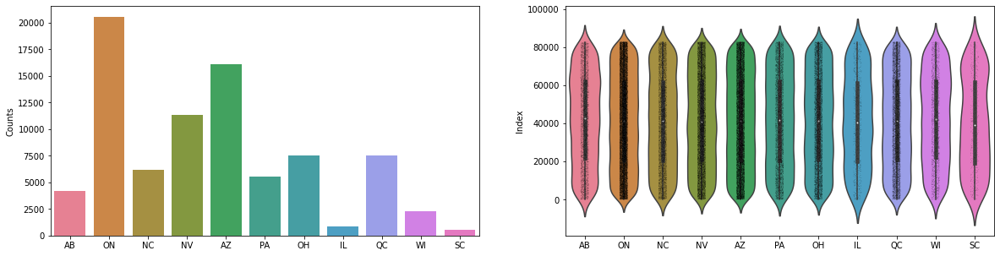

In [ ]:
fig, ax = plt.subplots(1,2,figsize=(20,5))
sns.countplot(df_business_final_3.state.values, ax=ax[0], palette="husl")
sns.violinplot(x=df_business_final_3.state.values, y=df_business_final_3.index.values, ax=ax[1], palette="husl")
sns.stripplot(x=df_business_final_3.state.values, y=df_business_final_3.index.values,
              jitter=True, ax=ax[1], color="black", size=0.5, alpha=0.5)
ax[1].set_ylabel("Index");
ax[0].set_ylabel("Counts")

<h3> Analise: </h3>
  <p>Temos 11 Estados avaliados e a maior concentracao das avaliacoes esta em Ontario-Canada. </p>

* A principio poderiamos criar um modelo voltado para todos os Estados buscando atender uma massa maior, porem como alguns Estados possuim mais avaliacoes que os outros, principalmente Ontario que concentra a maior parte. Isso acaba prejudicando o modelo.

*  Um outro ponto  é, escolhermos um Estado ou melhor, escolhermo o Estado com maior concentracao de avaliacoes para criarmos o modelo, pois assim ganhamos em termos de desempenho, o modelo consegue aprender muito mais e consequentimente a predição terá uma acurácia melhor.
 

#### Filtrando a base pelo Estado com maior concentração de avaliações(Ontário)
   Iremos focar em criar o modelo voltado para o Estado de Ontario

In [ ]:
ontario = df_business_final_3.groupby('state').get_group('ON')
ontario.head()

,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries,city,state,postal_code,latitude,longitude,stars,review_count,is_open,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,RestaurantsAttire,NoiseLevel,OutdoorSeating,GoodForKids,RestaurantsTableService,Caters,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsTakeOut,Alcohol,RestaurantsDelivery,WiFi,BikeParking,RestaurantsReservations,HasTV,BusinessAcceptsCreditCards,WheelchairAccessible,ByAppointmentOnly,HappyHour,BYOBCorkage,Corkage,DogsAllowed,CoatCheck,Smoking,GoodForDancing,BusinessAcceptsBitcoin,DriveThru,BYOB,AcceptsInsurance,AgesAllowed,HairSpecializesIn,Open24Hours,RestaurantsCounterService,amb_casual,amb_classy,amb_divey,amb_hipster,amb_intimate,amb_romantic,amb_touristy,amb_trendy,amb_upscale,gmf_breakfast,gfm_brunch,gfm_dessert,gfm_dinner,gfm_latenight,gfm_lunch,bp_garage,bp_lot,bp_street,bp_valet,bp_validated,music_background,music_dj,music_jukebox,music_karaoke,music_live,music_nomusic,music_video,bn_friday,bn_monday,bn_saturday,bn_sunday,bn_thursday,bn_tuesday,bn_wednesday,diet_dairy_free,diet_gluen_free,diet_halal,diet_kosher,diet_soy_free,diet_vegan,diet_vegetarian
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual','average',False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Toronto,ON,M6E,43.677807,-79.444674,4.0,51,1,7:0-15:0,7:0-15:0,7:0-15:0,7:0-15:0,7:0-16:0,7:0-16:0,7:0-16:0,u'casual',u'quiet',False,True,NaN,True,True,2,True,u'none',False,u'free',True,False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
13,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Toronto,ON,M1V 0C7,43.806750,-79.288858,3.5,43,0,11:0-0:0,11:0-0:0,11:0-0:0,11:0-0:0,11:0-1:0,10:30-1:0,10:30-0:0,u'casual',u'average',False,True,NaN,False,True,2,True,'none',False,'free',True,True,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
18,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3,0,East York,ON,M4K 3V9,43.688634,-79.348687,4.5,3,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
26,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Toronto,ON,M6G 1M2,43.662593,-79.423443,4.5,16,1,17:0-0:0,17:0-2:0,17:0-2:0,17:0-2:0,16:0-2:0,16:0-2:0,17:0-1:0,NaN,u'average',True,NaN,NaN,NaN,True,2,NaN,u'full_bar',NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,1.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:

def distribuicao(df, nGraphShown, nGraphPerRow):
    nunique = df.nunique()
    df = df[[col for col in df if nunique[col] > 1 and nunique[col] < 100]] 
    nRow, nCol = df.shape
    columnNames = list(df)
    nGraphRow = (nCol + nGraphPerRow - 1) / nGraphPerRow
    plt.figure(num = None, figsize = (6 * nGraphPerRow, 8 * nGraphRow), dpi = 100, facecolor = 'w', edgecolor = 'k')
    for i in range(min(nCol, nGraphShown)):
        plt.subplot(nGraphRow, nGraphPerRow, i + 1)
        columnDf = df.iloc[:, i]
        if (not np.issubdtype(type(columnDf.iloc[0]), np.number)):
            valueCounts = columnDf.value_counts()
            valueCounts.plot.bar()
        else:
            columnDf.hist()
        plt.ylabel('counts')
        plt.xticks(rotation = 100)
        plt.title(f'{columnNames[i]} (column {i})')
    plt.tight_layout(pad = 2.0, w_pad = 2.0, h_pad = 2.0)
    plt.show()

In [ ]:
def normal(df, col, threshold=0.05):
    try:
        zscore, p_value = stats.normaltest(df[col])
        if p_value < threshold:
            result = 'not_normal'
        else:
            result = 'normal'
    except:
        zscore = p_value = np.nan
        result = 'not_applicable'
    return result

def outliers_count_IQR(df, col):
    try:
        if len(df[col].unique())>2: # if para eliminar features binárias
            q1 = df[col].quantile(0.25)
            q3 = df[col].quantile(0.75)
            iqr_range = q3 - q1
            lower = q1 - 1.5*iqr_range
            upper = q3 + 1.5*iqr_range
            out_low = df[df[col] < lower].count()[0]
            out_up = df[df[col] > upper].count()[0]
            outliers = out_low + out_up
            outliers_perc = round(outliers / df.shape[0],2)
        else:
            outliers = np.nan
            outliers_perc = np.nan
    except:
        outliers = np.nan
        outliers_perc = np.nan
    return outliers, outliers_perc

def EDA_morestats(df):
    eda_df = {}
    eda_df['Amount_NaN'] = df.isnull().sum()
    eda_df['%_NaN'] = df.isnull().mean().round(2)
    eda_df['DType'] = df.dtypes
    eda_df['Amount_Data'] = df.count()
    

 
    colunas = df.columns.tolist()
    
        
    eda_df['Amount_Unique'] = pd.Series(map(lambda x: len(df[x].unique().tolist()), colunas), index=colunas)
    
    eda_df['Mean'] = df.mean().round(3)
    eda_df['Min'] = df.min()
    eda_df['Max'] = df.max()
    eda_df['STD'] = df.std().round(3)
    eda_df['Normality'] = pd.Series(map(lambda x: normal(df, x), colunas), index=colunas)
    eda_df['Amount_Outliers'] = pd.Series(map(lambda x: outliers_count_IQR(df, x)[0], colunas), index=colunas)
    eda_df['%_Outliers'] = pd.Series(map(lambda x: outliers_count_IQR(df, x)[1], colunas), index=colunas)
    df = pd.DataFrame(eda_df)
    return df.loc[colunas,:]

* Fazendo à analise dos dados de 20 em 20 Colunas, pelo fato de termos uma base bem grande

In [ ]:

EDA_morestats(ontario).iloc[:20]

,Amount_NaN,%_NaN,DType,Amount_Data,Amount_Unique,Mean,Min,Max,STD,Normality,Amount_Outliers,%_Outliers
bars,0,0.0,int64,20525,5,0.107,0,4,0.373,not_normal,1803.0,0.09
breweries,0,0.0,int64,20525,2,0.001,0,1,0.030,not_normal,NaN,NaN
cafes,0,0.0,int64,20525,2,0.000,0,1,0.016,not_normal,NaN,NaN
caribbean,0,0.0,int64,20525,2,0.000,0,1,0.012,not_normal,NaN,NaN
chinese,0,0.0,int64,20525,3,0.014,0,2,0.123,not_normal,273.0,0.01
food,0,0.0,int64,20525,8,0.904,0,7,1.261,not_normal,25.0,0.00
french,0,0.0,int64,20525,2,0.000,0,1,0.010,not_normal,NaN,NaN
gourmet,0,0.0,int64,20525,4,0.039,0,3,0.210,not_normal,747.0,0.04
italian,0,0.0,int64,20525,1,0.000,0,0,0.000,not_normal,NaN,NaN
japanese,0,0.0,int64,20525,3,0.005,0,3,0.073,not_normal,103.0,0.01


In [ ]:
EDA_morestats(ontario).iloc[20:40]

,Amount_NaN,%_NaN,DType,Amount_Data,Amount_Unique,Mean,Min,Max,STD,Normality,Amount_Outliers,%_Outliers
latitude,0,0.00,float64,20525,17500,43.717,43.4501,44.1479,0.104,not_normal,521.0,0.03
longitude,0,0.00,float64,20525,17296,-79.428,-79.9471,-78.9001,0.148,not_normal,2419.0,0.12
stars,0,0.00,float64,20525,9,3.402,1,5,0.785,not_normal,153.0,0.01
review_count,0,0.00,int64,20525,452,35.561,3,2758,68.790,not_normal,2115.0,0.10
is_open,0,0.00,int64,20525,2,0.699,0,1,0.459,not_normal,NaN,NaN
Monday,6764,0.33,object,13761,590,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
Tuesday,5725,0.28,object,14800,612,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
Wednesday,5330,0.26,object,15195,608,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
Thursday,5202,0.25,object,15323,618,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
Friday,5173,0.25,object,15352,656,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN


In [ ]:
EDA_morestats(ontario).iloc[40:60]

,Amount_NaN,%_NaN,DType,Amount_Data,Amount_Unique,Mean,Min,Max,STD,Normality,Amount_Outliers,%_Outliers
RestaurantsTakeOut,4548,0.22,object,15977,4,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
Alcohol,9019,0.44,object,11506,8,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
RestaurantsDelivery,7372,0.36,object,13153,4,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
WiFi,8435,0.41,object,12090,8,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
BikeParking,7974,0.39,object,12551,4,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
RestaurantsReservations,7274,0.35,object,13251,4,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
HasTV,7898,0.38,object,12627,4,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
BusinessAcceptsCreditCards,19920,0.97,object,605,4,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
WheelchairAccessible,17482,0.85,object,3043,4,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
ByAppointmentOnly,19844,0.97,object,681,4,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN


In [ ]:
EDA_morestats(ontario).iloc[60:80]

,Amount_NaN,%_NaN,DType,Amount_Data,Amount_Unique,Mean,Min,Max,STD,Normality,Amount_Outliers,%_Outliers
AcceptsInsurance,20515,1.00,object,10,3,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
AgesAllowed,20517,1.00,object,8,2,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
HairSpecializesIn,20522,1.00,object,3,4,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
Open24Hours,20523,1.00,object,2,3,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
RestaurantsCounterService,20524,1.00,object,1,2,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
amb_casual,7709,0.38,float64,12816,3,0.368,0,1,0.482,normal,0.0,0.00
amb_classy,7809,0.38,float64,12716,3,0.122,0,1,0.327,normal,1549.0,0.08
amb_divey,15094,0.74,float64,5431,2,0.000,0,0,0.000,normal,NaN,NaN
amb_hipster,8260,0.40,float64,12265,3,0.023,0,1,0.151,normal,286.0,0.01
amb_intimate,7858,0.38,float64,12667,3,0.014,0,1,0.117,normal,176.0,0.01


 #### Eliminando colunas que tenham grandes quantidades de dados faltantes

In [ ]:
ontario.drop(columns=['BusinessAcceptsCreditCards'] , axis=1, inplace=True)
ontario.head()

,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries,city,state,postal_code,latitude,longitude,stars,review_count,is_open,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,RestaurantsAttire,NoiseLevel,OutdoorSeating,GoodForKids,RestaurantsTableService,Caters,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsTakeOut,Alcohol,RestaurantsDelivery,WiFi,BikeParking,RestaurantsReservations,HasTV,WheelchairAccessible,ByAppointmentOnly,HappyHour,BYOBCorkage,Corkage,DogsAllowed,CoatCheck,Smoking,GoodForDancing,BusinessAcceptsBitcoin,DriveThru,BYOB,AcceptsInsurance,AgesAllowed,HairSpecializesIn,Open24Hours,RestaurantsCounterService,amb_casual,amb_classy,amb_divey,amb_hipster,amb_intimate,amb_romantic,amb_touristy,amb_trendy,amb_upscale,gmf_breakfast,gfm_brunch,gfm_dessert,gfm_dinner,gfm_latenight,gfm_lunch,bp_garage,bp_lot,bp_street,bp_valet,bp_validated,music_background,music_dj,music_jukebox,music_karaoke,music_live,music_nomusic,music_video,bn_friday,bn_monday,bn_saturday,bn_sunday,bn_thursday,bn_tuesday,bn_wednesday,diet_dairy_free,diet_gluen_free,diet_halal,diet_kosher,diet_soy_free,diet_vegan,diet_vegetarian
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Richmond Hill,ON,L4B 3P7,43.841694,-79.399755,3.0,55,1,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,11:0-22:30,u'casual','average',False,True,True,True,True,2,True,'beer_and_wine',False,u'no',False,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Toronto,ON,M6E,43.677807,-79.444674,4.0,51,1,7:0-15:0,7:0-15:0,7:0-15:0,7:0-15:0,7:0-16:0,7:0-16:0,7:0-16:0,u'casual',u'quiet',False,True,NaN,True,True,2,True,u'none',False,u'free',True,False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
13,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Toronto,ON,M1V 0C7,43.806750,-79.288858,3.5,43,0,11:0-0:0,11:0-0:0,11:0-0:0,11:0-0:0,11:0-1:0,10:30-1:0,10:30-0:0,u'casual',u'average',False,True,NaN,False,True,2,True,'none',False,'free',True,True,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
18,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3,0,East York,ON,M4K 3V9,43.688634,-79.348687,4.5,3,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
26,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Toronto,ON,M6G 1M2,43.662593,-79.423443,4.5,16,1,17:0-0:0,17:0-2:0,17:0-2:0,17:0-2:0,16:0-2:0,16:0-2:0,17:0-1:0,NaN,u'average',True,NaN,NaN,NaN,True,2,NaN,u'full_bar',NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,1.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### Distribuição das colunas em um histograma para analisarmos as distribuições das variaveis, como seus dados estao distribuidos

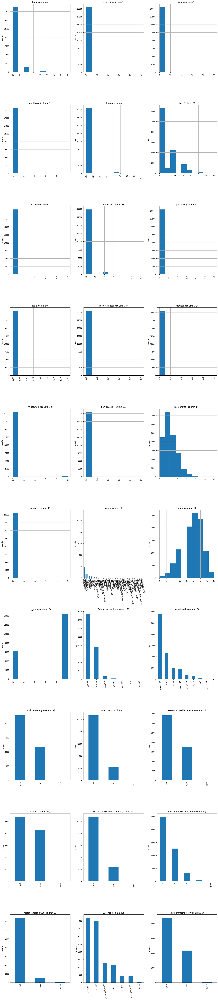

In [ ]:
distribuicao(ontario,30, 3)

#### Arrumando valores errados do novo dataframe clean

In [ ]:
def EDA_values(df):
    print("")
    counter=0

    # identifica a qtd de caracteres da maior coluna para depois poder calcular quantos espacos sao necessarios para que as colunas com nomes 
    # menores fiquem alinhadas
    max_col_name_char = 0
    for col_name in df.columns:
        if len(col_name) > max_col_name_char:
            max_col_name_char = len(col_name)+1

    # calcula a qtd de colunas para depois poder calcular quantos espacos sao necessarios para que os indices das colunas fiquem alinhados 
    if len(df.columns) < 10:
        digits = 0
    elif len(df.columns) < 100:
        digits = 1
    else:
        digits = 2

    for i in df.columns:
        if len(df[i].unique()) < 23:
            print(' '*(digits-counter//10), counter, '|', i, ' '*(max_col_name_char - len(i))+'| ', df[i].unique())
        else:
            try:
                print(' '*(digits-counter//10), counter, '|', i, ' '*(max_col_name_char - len(i))+'|  '+'Min:', data[i].unique().min(), '| Max:', data[i].unique().max(), '| Avg:',round(df[i].dropna().unique().mean(),2), '| Median:',round(np.median(df[i].dropna().unique()),2))
            except:
                print(' '*(digits-counter//10), counter, '|', i, ' '*(max_col_name_char - len(i))+'|  '+'Min:', df[i].unique().min(), '| Max:', df[i].unique().max())

        counter += 1
    return None

In [ ]:
ontario_1 = ontario

In [ ]:
ontario_1['NoiseLevel'].unique()

array(["'average'", "u'quiet'", "u'average'", nan, "u'loud'",
       "u'very_loud'", "'quiet'", "'loud'", "'very_loud'", 'None'],
      dtype=object)

In [ ]:
EDA_values(ontario_1[['bars', 'breweries', 'cafes', 'caribbean', 'chinese', 'food', 'french',
       'gourmet', 'italian', 'japanese', 'latin', 'mediterranean', 'mexican',
       'mideastern', 'portuguese', 'restaurants', 'wineries', 'city', 'state',
       'postal_code', 'latitude', 'longitude', 'stars', 'review_count',
       'is_open', 'RestaurantsAttire', 'NoiseLevel',
       'OutdoorSeating', 'GoodForKids', 'RestaurantsTableService', 'Caters',
       'RestaurantsGoodForGroups', 'RestaurantsPriceRange2',
       'RestaurantsTakeOut', 'Alcohol', 'RestaurantsDelivery', 'WiFi',
       'BikeParking', 'RestaurantsReservations', 'HasTV', 'amb_casual', 'amb_classy', 'amb_divey',
       'amb_hipster', 'amb_intimate', 'amb_romantic', 'amb_touristy',
       'amb_trendy', 'amb_upscale', 'gmf_breakfast', 'gfm_brunch',
       'gfm_dessert', 'gfm_dinner', 'gfm_latenight', 'gfm_lunch', 'bp_garage',
       'bp_lot', 'bp_street', 'bp_valet', 'bp_validated']])


  0 | bars                     |  [0 1 2 4 3]
  1 | breweries                |  [0 1]
  2 | cafes                    |  [0 1]
  3 | caribbean                |  [0 1]
  4 | chinese                  |  [0 1 2]
  5 | food                     |  [0 2 1 3 4 5 6 7]
  6 | french                   |  [0 1]
  7 | gourmet                  |  [0 2 1 3]
  8 | italian                  |  [0]
  9 | japanese                 |  [0 1 3]
 10 | latin                    |  [0 1 2]
 11 | mediterranean            |  [0 1]
 12 | mexican                  |  [0 1]
 13 | mideastern               |  [0 1]
 14 | portuguese               |  [0 1]
 15 | restaurants              |  [ 2  3  0  4  5  1  6  7  9 12  8 10]
 16 | wineries                 |  [0 1]
 17 | city                     |  Min: Agincourt | Max: Zephyr
 18 | state                    |  ['ON']
 19 | postal_code              |  Min:  | Max: W8M 3T5
 20 | latitude                 |  Min: 43.4500823 | Max: 44.1479094
 21 | longitude                |  

In [ ]:
ontario_1['RestaurantsAttire'] = ontario_1['RestaurantsAttire'].replace({"u'":"","'":"","None":np.nan}, regex=True)
ontario_1['NoiseLevel'] = ontario_1['NoiseLevel'].replace({"u'":"","'":"","None":np.nan}, regex=True)
ontario_1['OutdoorSeating'] = ontario_1['OutdoorSeating'].replace({"u'":"","'":"","None":np.nan}, regex=True)
ontario_1['GoodForKids'] = ontario_1['GoodForKids'].replace({"u'":"","'":"","None":np.nan}, regex=True)
ontario_1['RestaurantsTableService'] = ontario_1['RestaurantsTableService'].replace({"u'":"","'":"","None":np.nan}, regex=True)
ontario_1['Caters'] = ontario_1['Caters'].replace({"u'":"","'":"","None":np.nan}, regex=True)
ontario_1['RestaurantsGoodForGroups'] = ontario_1['RestaurantsGoodForGroups'].replace({"u'":"","'":"","None":np.nan}, regex=True)
ontario_1['RestaurantsPriceRange2'] = ontario_1['RestaurantsPriceRange2'].replace({"u'":"","'":"","None":np.nan}, regex=True)
ontario_1['RestaurantsTakeOut'] = ontario_1['RestaurantsTakeOut'].replace({"u'":"","'":"","None":np.nan}, regex=True)
ontario_1['Alcohol'] = ontario_1['Alcohol'].replace({"u'":"","'":"","None":np.nan}, regex=True)
ontario_1['RestaurantsDelivery'] = ontario_1['RestaurantsDelivery'].replace({"u'":"","'":"","None":np.nan}, regex=True)
ontario_1['WiFi'] = ontario_1['WiFi'].replace({"u'":"","'":"","None":np.nan}, regex=True)
ontario_1['BikeParking'] = ontario_1['BikeParking'].replace({"u'":"","'":"","None":np.nan}, regex=True)
ontario_1['RestaurantsReservations'] = ontario_1['RestaurantsReservations'].replace({"u'":"","'":"","None":np.nan}, regex=True)
ontario_1['HasTV'] = ontario_1['HasTV'].replace({"u'":"","'":"","None":np.nan}, regex=True)


In [ ]:
EDA_values(ontario_1[['bars', 'breweries', 'cafes', 'caribbean', 'chinese', 'food', 'french',
       'gourmet', 'italian', 'japanese', 'latin', 'mediterranean', 'mexican',
       'mideastern', 'portuguese', 'restaurants', 'wineries', 'city', 'state',
       'postal_code', 'latitude', 'longitude', 'stars', 'review_count',
       'is_open', 'RestaurantsAttire', 'NoiseLevel',
       'OutdoorSeating', 'GoodForKids', 'RestaurantsTableService', 'Caters',
       'RestaurantsGoodForGroups', 'RestaurantsPriceRange2',
       'RestaurantsTakeOut', 'Alcohol', 'RestaurantsDelivery', 'WiFi',
       'BikeParking', 'RestaurantsReservations', 'HasTV', 'amb_casual', 'amb_classy', 'amb_divey',
       'amb_hipster', 'amb_intimate', 'amb_romantic', 'amb_touristy',
       'amb_trendy', 'amb_upscale', 'gmf_breakfast', 'gfm_brunch',
       'gfm_dessert', 'gfm_dinner', 'gfm_latenight', 'gfm_lunch', 'bp_garage',
       'bp_lot', 'bp_street', 'bp_valet', 'bp_validated']])


  0 | bars                     |  [0 1 2 4 3]
  1 | breweries                |  [0 1]
  2 | cafes                    |  [0 1]
  3 | caribbean                |  [0 1]
  4 | chinese                  |  [0 1 2]
  5 | food                     |  [0 2 1 3 4 5 6 7]
  6 | french                   |  [0 1]
  7 | gourmet                  |  [0 2 1 3]
  8 | italian                  |  [0]
  9 | japanese                 |  [0 1 3]
 10 | latin                    |  [0 1 2]
 11 | mediterranean            |  [0 1]
 12 | mexican                  |  [0 1]
 13 | mideastern               |  [0 1]
 14 | portuguese               |  [0 1]
 15 | restaurants              |  [ 2  3  0  4  5  1  6  7  9 12  8 10]
 16 | wineries                 |  [0 1]
 17 | city                     |  Min: Agincourt | Max: Zephyr
 18 | state                    |  ['ON']
 19 | postal_code              |  Min:  | Max: W8M 3T5
 20 | latitude                 |  Min: 43.4500823 | Max: 44.1479094
 21 | longitude                |  

* Vamos analisar novamente os dados com a EDA_moreastats apos fazermos a substituicao dos dados que tinham none para nan

In [ ]:
EDA_morestats(ontario_1).iloc[:20]

,Amount_NaN,%_NaN,DType,Amount_Data,Amount_Unique,Mean,Min,Max,STD,Normality,Amount_Outliers,%_Outliers
bars,0,0.0,int64,20525,5,0.107,0,4,0.373,not_normal,1803.0,0.09
breweries,0,0.0,int64,20525,2,0.001,0,1,0.030,not_normal,NaN,NaN
cafes,0,0.0,int64,20525,2,0.000,0,1,0.016,not_normal,NaN,NaN
caribbean,0,0.0,int64,20525,2,0.000,0,1,0.012,not_normal,NaN,NaN
chinese,0,0.0,int64,20525,3,0.014,0,2,0.123,not_normal,273.0,0.01
food,0,0.0,int64,20525,8,0.904,0,7,1.261,not_normal,25.0,0.00
french,0,0.0,int64,20525,2,0.000,0,1,0.010,not_normal,NaN,NaN
gourmet,0,0.0,int64,20525,4,0.039,0,3,0.210,not_normal,747.0,0.04
italian,0,0.0,int64,20525,1,0.000,0,0,0.000,not_normal,NaN,NaN
japanese,0,0.0,int64,20525,3,0.005,0,3,0.073,not_normal,103.0,0.01


In [ ]:
EDA_morestats(ontario_1).iloc[20:40]

,Amount_NaN,%_NaN,DType,Amount_Data,Amount_Unique,Mean,Min,Max,STD,Normality,Amount_Outliers,%_Outliers
latitude,0,0.00,float64,20525,17500,43.717,43.4501,44.1479,0.104,not_normal,521.0,0.03
longitude,0,0.00,float64,20525,17296,-79.428,-79.9471,-78.9001,0.148,not_normal,2419.0,0.12
stars,0,0.00,float64,20525,9,3.402,1,5,0.785,not_normal,153.0,0.01
review_count,0,0.00,int64,20525,452,35.561,3,2758,68.790,not_normal,2115.0,0.10
is_open,0,0.00,int64,20525,2,0.699,0,1,0.459,not_normal,NaN,NaN
Monday,6764,0.33,object,13761,590,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
Tuesday,5725,0.28,object,14800,612,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
Wednesday,5330,0.26,object,15195,608,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
Thursday,5202,0.25,object,15323,618,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
Friday,5173,0.25,object,15352,656,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN


In [ ]:
EDA_morestats(ontario_1).iloc[40:60]

,Amount_NaN,%_NaN,DType,Amount_Data,Amount_Unique,Mean,Min,Max,STD,Normality,Amount_Outliers,%_Outliers
RestaurantsTakeOut,4558,0.22,object,15967,3,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
Alcohol,9027,0.44,object,11498,4,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
RestaurantsDelivery,7382,0.36,object,13143,3,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
WiFi,8444,0.41,object,12081,4,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
BikeParking,7985,0.39,object,12540,3,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
RestaurantsReservations,7336,0.36,object,13189,3,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
HasTV,7902,0.38,object,12623,3,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
WheelchairAccessible,17482,0.85,object,3043,4,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
ByAppointmentOnly,19844,0.97,object,681,4,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
HappyHour,18527,0.90,object,1998,4,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN


In [ ]:
EDA_morestats(ontario_1).iloc[60:80]

,Amount_NaN,%_NaN,DType,Amount_Data,Amount_Unique,Mean,Min,Max,STD,Normality,Amount_Outliers,%_Outliers
AgesAllowed,20517,1.00,object,8,2,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
HairSpecializesIn,20522,1.00,object,3,4,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
Open24Hours,20523,1.00,object,2,3,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
RestaurantsCounterService,20524,1.00,object,1,2,NaN,NaN,NaN,NaN,not_applicable,NaN,NaN
amb_casual,7709,0.38,float64,12816,3,0.368,0,1,0.482,normal,0.0,0.00
amb_classy,7809,0.38,float64,12716,3,0.122,0,1,0.327,normal,1549.0,0.08
amb_divey,15094,0.74,float64,5431,2,0.000,0,0,0.000,normal,NaN,NaN
amb_hipster,8260,0.40,float64,12265,3,0.023,0,1,0.151,normal,286.0,0.01
amb_intimate,7858,0.38,float64,12667,3,0.014,0,1,0.117,normal,176.0,0.01
amb_romantic,7806,0.38,float64,12719,3,0.011,0,1,0.103,normal,136.0,0.01


In [ ]:
EDA_morestats(ontario_1).iloc[80:100]

,Amount_NaN,%_NaN,DType,Amount_Data,Amount_Unique,Mean,Min,Max,STD,Normality,Amount_Outliers,%_Outliers
bp_lot,4173,0.20,float64,16352,3,0.284,0,1,0.451,normal,0.0,0.00
bp_street,4236,0.21,float64,16289,3,0.296,0,1,0.456,normal,0.0,0.00
bp_valet,4129,0.20,float64,16396,3,0.008,0,1,0.087,normal,124.0,0.01
bp_validated,4244,0.21,float64,16281,3,0.008,0,1,0.089,normal,129.0,0.01
music_background,19306,0.94,float64,1219,3,0.098,0,1,0.297,normal,119.0,0.01
music_dj,19259,0.94,float64,1266,3,0.067,0,1,0.250,normal,85.0,0.00
music_jukebox,19315,0.94,float64,1210,3,0.013,0,1,0.114,normal,16.0,0.00
music_karaoke,19327,0.94,float64,1198,3,0.014,0,1,0.118,normal,17.0,0.00
music_live,19309,0.94,float64,1216,3,0.164,0,1,0.371,normal,200.0,0.01
music_nomusic,19392,0.94,float64,1133,2,0.000,0,0,0.000,normal,NaN,NaN


In [ ]:
EDA_morestats(ontario_1).iloc[100:120]

,Amount_NaN,%_NaN,DType,Amount_Data,Amount_Unique,Mean,Min,Max,STD,Normality,Amount_Outliers,%_Outliers
diet_halal,20510,1.0,float64,15,3,0.133,0,1,0.352,normal,2.0,0.0
diet_kosher,20510,1.0,float64,15,2,0.000,0,0,0.000,normal,NaN,NaN
diet_soy_free,20510,1.0,float64,15,2,0.000,0,0,0.000,normal,NaN,NaN
diet_vegan,20510,1.0,float64,15,3,0.667,0,1,0.488,normal,0.0,0.0
diet_vegetarian,20510,1.0,float64,15,3,0.200,0,1,0.414,normal,3.0,0.0


 ### Eliminando a variavel RestaurantsTableService por ter mais de 90% dos dados nulos

In [ ]:
ontario_2 = ontario_1.drop(columns=['ByAppointmentOnly','HappyHour','BYOBCorkage','Corkage','DogsAllowed','CoatCheck','Smoking','GoodForDancing','BusinessAcceptsBitcoin','DriveThru','BYOB','AcceptsInsurance','AgesAllowed', 'HairSpecializesIn', 'Open24Hours', 'RestaurantsCounterService','RestaurantsTableService','diet_halal', 'diet_kosher', 'diet_soy_free', 'diet_vegan', 'diet_vegetarian', 'music_background', 'music_dj',
'music_jukebox', 'music_karaoke', 'music_live', 'music_nomusic', 'music_video','bn_friday', 'bn_monday', 'bn_monday', 'bn_sunday', 'bn_thursday',
'bn_tuesday', 'bn_wednesday', 'diet_dairy_free', 'diet_gluen_free' ], axis=1)

In [ ]:
ontario_2.shape

(20525, 68)

Analisando a quantidade de avaliações por tipo de estabelecimento/ Qual ou quais tem a maior nota?

In [ ]:
ontario_2[['stars', 'bars', 'breweries','cafes','caribbean','chinese','food','french','gourmet', 'italian', 'mexican', 'japanese', 'latin','mediterranean','mideastern','portuguese',	'restaurants','wineries']].groupby(['stars']).sum().T

stars,1.0,1.5,2.0,2.5,3.0,3.5,4.0,4.5,5.0
bars,13,19,104,267,523,609,458,181,27
breweries,0,0,0,0,2,7,6,3,0
cafes,0,0,0,1,1,0,1,2,0
caribbean,0,0,0,0,0,1,2,0,0
chinese,1,0,9,29,98,95,41,11,2
food,109,400,919,1797,3219,4147,4606,2621,729
french,0,0,0,0,0,1,1,0,0
gourmet,2,14,19,54,96,161,221,176,64
italian,0,0,0,0,0,0,0,0,0
mexican,0,0,0,1,0,0,0,1,0


#### Análise:
   Os estabelecimentos com as maiores avaliações são:
   * Os foods - Que devem ser as comidas prontas rápidas;
   * Os Restaurants - Que devem servir comidas em geral e 
   * Bars - Onde tem bebidas.

Esses são os três estabelecimentos que têm a maior frequência de usuários e consequentimente terá um número maior de avaliações, em regra.<br>
Tem muitas pessoas que não avaliam o estabelecimento que frequenta, então para se ter uma grande quantidade de avaliação o estabelecimento também precisa ter uma quantidade muito grande de visitas/frquência, isso pode talvez explicar a quantidade muito pequena de avalição dos demais estabelecimentos.

Os Restaurants possuem a melhor avaliação.

## Quais são as Cidades mais  avaliadas ?

In [ ]:
import folium
from folium import plugins

In [ ]:
coordenadas=[]
for lat,lng in zip(ontario.latitude.values,ontario.longitude.values):
  coordenadas.append([lat,lng])

In [ ]:
mapa = folium.Map(location=[50.000000,-85.000000],zoom_start=5,tiles='Stamen Toner')

In [ ]:
mapa.add_child(plugins.HeatMap(coordenadas))        
mapa


In [ ]:
mapa.save('mapa-ontario.html')


In [ ]:
ontario_2.city.value_counts()

Toronto                          11320
Mississauga                       1950
Markham                           1167
Brampton                           696
Richmond Hill                      677
Scarborough                        675
Vaughan                            638
North York                         617
Etobicoke                          421
Newmarket                          252
Oakville                           238
Thornhill                          223
Pickering                          222
Ajax                               215
Whitby                             201
Aurora                             174
Woodbridge                         130
East York                           78
York                                68
Stouffville                         53
Concord                             53
Whitchurch-Stouffville              40
Maple                               39
Bolton                              36
Unionville                          33
Georgetown               

 #### Análise:

* Olhando para o mapa conseguimos identificar Toronto e Mississauga com a maior  concentração de avaliações.

* Olhandos para a tabela acima conseguimos identificar as cinco cidades mais avaliadas que é Toronto, Mississauga, Markham, Brampton e Richmond Hill. Sendo Toronto e Mississauga com a maior concentração.  

* Essas top 5 terão uma influência maior sobre o modelo, principalmente  Toronto que é a top 1 das avaliações.

* Talvez possamos trabalhar com essas top 5, pois a concentração maior das avaliações estão com elas.

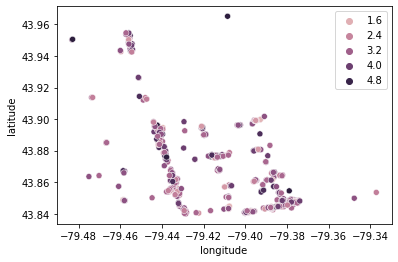

In [ ]:
richmond_hill = ontario_2.loc[ontario_2.city == 'Richmond Hill']
sns.scatterplot(data=richmond_hill, x='longitude', y='latitude', hue=richmond_hill['stars'].tolist())
    

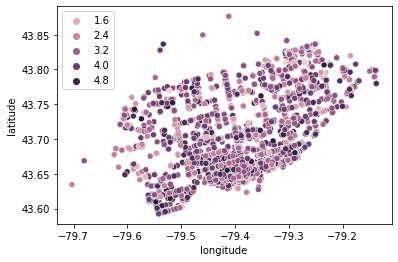

In [ ]:
toronto = ontario_2.loc[ontario_2.city == 'Toronto']
sns.scatterplot(data=toronto, x='longitude', y='latitude', hue=toronto['stars'].tolist())

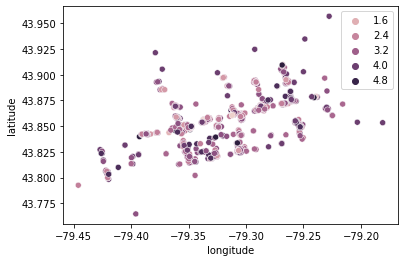

In [ ]:
markham = ontario_2.loc[ontario_2.city == 'Markham']
sns.scatterplot(data=markham, x='longitude', y='latitude', hue=markham['stars'].tolist())

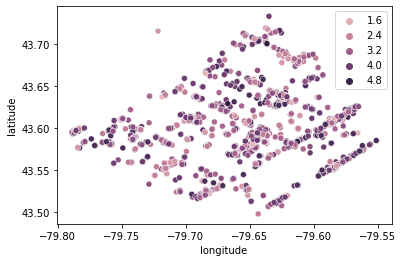

In [ ]:
mississauga = ontario_2.loc[ontario_2.city == 'Mississauga']
sns.scatterplot(data=mississauga, x='longitude', y='latitude', hue=mississauga['stars'].tolist())

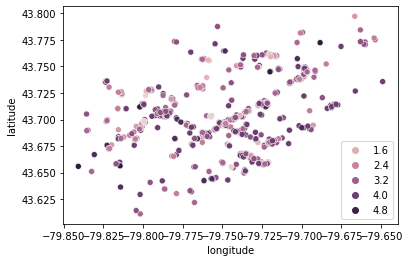

In [ ]:
brampton = ontario_2.loc[ontario_2.city == 'Brampton']
sns.scatterplot(data=brampton, x='longitude', y='latitude', hue=brampton['stars'].tolist())
    

### Preparação dos Dados Para  o Modelagem

* Escolhemos a cidade de Toronto  da provincia  de Ontario para criar nosso modelo



In [ ]:
 toronto.head()

,bars,breweries,cafes,caribbean,chinese,food,french,gourmet,italian,japanese,latin,mediterranean,mexican,mideastern,portuguese,restaurants,wineries,city,state,postal_code,latitude,longitude,stars,review_count,is_open,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,RestaurantsAttire,NoiseLevel,OutdoorSeating,GoodForKids,Caters,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsTakeOut,Alcohol,RestaurantsDelivery,WiFi,BikeParking,RestaurantsReservations,HasTV,WheelchairAccessible,amb_casual,amb_classy,amb_divey,amb_hipster,amb_intimate,amb_romantic,amb_touristy,amb_trendy,amb_upscale,gmf_breakfast,gfm_brunch,gfm_dessert,gfm_dinner,gfm_latenight,gfm_lunch,bp_garage,bp_lot,bp_street,bp_valet,bp_validated,bn_saturday
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Toronto,ON,M6E,43.677807,-79.444674,4.0,51,1,7:0-15:0,7:0-15:0,7:0-15:0,7:0-15:0,7:0-16:0,7:0-16:0,7:0-16:0,casual,quiet,False,True,True,True,2,True,none,False,free,True,False,True,NaN,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,NaN
13,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,Toronto,ON,M1V 0C7,43.806750,-79.288858,3.5,43,0,11:0-0:0,11:0-0:0,11:0-0:0,11:0-0:0,11:0-1:0,10:30-1:0,10:30-0:0,casual,average,False,True,False,True,2,True,none,False,free,True,True,False,NaN,1.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,NaN
26,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Toronto,ON,M6G 1M2,43.662593,-79.423443,4.5,16,1,17:0-0:0,17:0-2:0,17:0-2:0,17:0-2:0,16:0-2:0,16:0-2:0,17:0-1:0,NaN,average,True,NaN,NaN,True,2,NaN,full_bar,NaN,NaN,NaN,NaN,NaN,NaN,0.0,1.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
29,0,0,0,0,0,2,0,2,0,0,0,0,0,0,0,0,0,Toronto,ON,M6G 1L4,43.663713,-79.417759,3.5,11,0,9:0-19:30,9:0-19:30,9:0-19:30,9:0-19:30,9:0-19:30,10:0-18:30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,NaN,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,0.0,0.0,NaN
32,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3,0,Toronto,ON,M5X 1K7,43.649103,-79.380621,3.0,22,0,11:0-21:0,11:0-21:0,11:0-21:0,11:0-21:0,11:0-20:30,NaN,NaN,casual,average,False,False,True,True,2,True,full_bar,False,free,True,True,True,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,0.0,0.0,0.0,NaN


#### Excluindo algumas features que não serão usadas na modelagem

In [ ]:
toronto_2 = toronto.drop(columns=['bars','breweries', 'cafes', 'caribbean', 'chinese', 'food', 'french','gourmet','italian', 'japanese', 
                                  'latin', 'mediterranean', 'mexican',	'mideastern', 'portuguese',	'restaurants', 'wineries', 'city', 'state',  'postal_code', 'Monday', 'Tuesday',
                                  'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday', 'bn_saturday', 'amb_casual', 'amb_classy','amb_divey', 'amb_hipster',	
                                  'amb_intimate',	'amb_romantic',	'amb_touristy',	'amb_trendy', 'amb_upscale'],  axis=1)

In [ ]:
toronto_2.head()

,latitude,longitude,stars,review_count,is_open,RestaurantsAttire,NoiseLevel,OutdoorSeating,GoodForKids,Caters,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsTakeOut,Alcohol,RestaurantsDelivery,WiFi,BikeParking,RestaurantsReservations,HasTV,WheelchairAccessible,gmf_breakfast,gfm_brunch,gfm_dessert,gfm_dinner,gfm_latenight,gfm_lunch,bp_garage,bp_lot,bp_street,bp_valet,bp_validated
4,43.677807,-79.444674,4.0,51,1,casual,quiet,False,True,True,True,2,True,none,False,free,True,False,True,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
13,43.806750,-79.288858,3.5,43,0,casual,average,False,True,False,True,2,True,none,False,free,True,True,False,NaN,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
26,43.662593,-79.423443,4.5,16,1,NaN,average,True,NaN,NaN,True,2,NaN,full_bar,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
29,43.663713,-79.417759,3.5,11,0,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,NaN,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,0.0,0.0
32,43.649103,-79.380621,3.0,22,0,casual,average,False,False,True,True,2,True,full_bar,False,free,True,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,0.0,0.0,0.0


In [ ]:
toronto_2 = toronto_2.reset_index()

In [ ]:
toronto_2.head()

,index,latitude,longitude,stars,review_count,is_open,RestaurantsAttire,NoiseLevel,OutdoorSeating,GoodForKids,Caters,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsTakeOut,Alcohol,RestaurantsDelivery,WiFi,BikeParking,RestaurantsReservations,HasTV,WheelchairAccessible,gmf_breakfast,gfm_brunch,gfm_dessert,gfm_dinner,gfm_latenight,gfm_lunch,bp_garage,bp_lot,bp_street,bp_valet,bp_validated
0,4,43.677807,-79.444674,4.0,51,1,casual,quiet,False,True,True,True,2,True,none,False,free,True,False,True,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1,13,43.806750,-79.288858,3.5,43,0,casual,average,False,True,False,True,2,True,none,False,free,True,True,False,NaN,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
2,26,43.662593,-79.423443,4.5,16,1,NaN,average,True,NaN,NaN,True,2,NaN,full_bar,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,29,43.663713,-79.417759,3.5,11,0,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,NaN,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,0.0,0.0
4,32,43.649103,-79.380621,3.0,22,0,casual,average,False,False,True,True,2,True,full_bar,False,free,True,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,0.0,0.0,0.0


In [ ]:
 toronto_2 = toronto_2.drop(columns=['index'], axis=1)

In [ ]:
toronto_2.shape

(11320, 31)

### É possível identificar alguma correlação?




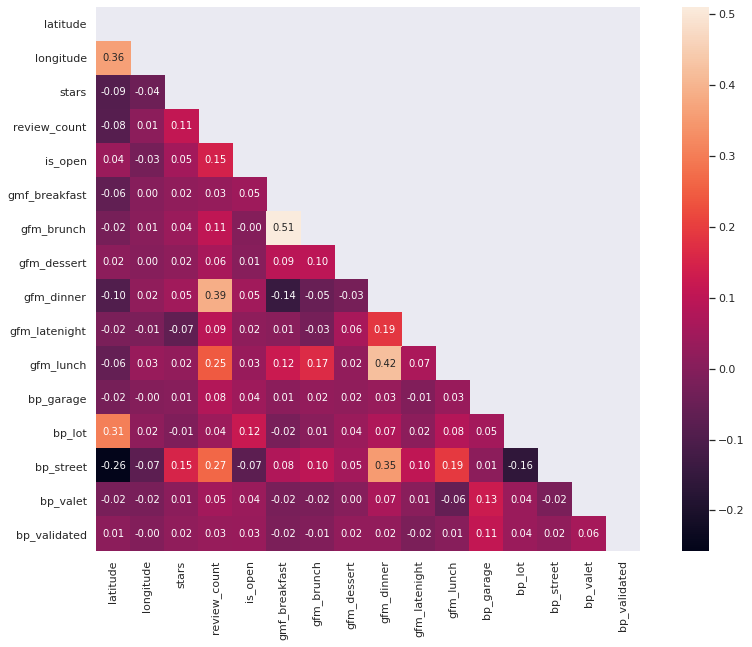

In [ ]:
on_corr = toronto_2.corr()
sns.set(font_scale=1.0)
f, ax = plt.subplots(figsize=(15, 10))

mask = np.triu(np.ones_like(on_corr, dtype=bool))
hm = sns.heatmap(on_corr, 
                 mask=mask,
                 cbar=True, # formatando a barra lateral de cores para o heatmap
                 annot=True, 
                 square=True, 
                 fmt='.2f', 
                 annot_kws={'size': 10}, 
                 yticklabels=on_corr.columns, 
                 xticklabels=on_corr.columns)

#### Análise:

Não existe fortes correlações entre as features e a variavel target

 #### Analisando valores ausentes

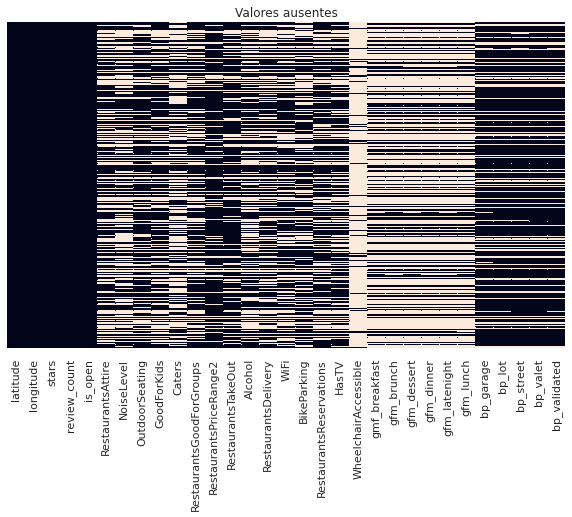

In [ ]:
plt.figure (figsize = (10, 6)) 
sns.heatmap (toronto_2.isnull (), yticklabels = False, cbar = False) 
plt.title ("Valores ausentes");


#### Mudando o dtype de algumas features  de int para float e objet para string

In [ ]:
toronto_2[['RestaurantsAttire', 'NoiseLevel', 'OutdoorSeating', 'GoodForKids', 'Caters', 'RestaurantsGoodForGroups', 'RestaurantsPriceRange2', 'RestaurantsTakeOut', 	'Alcohol', 'RestaurantsDelivery', 'WiFi', 'BikeParking', 'RestaurantsReservations', 'HasTV', 'WheelchairAccessible']]= toronto_2[['RestaurantsAttire', 'NoiseLevel', 'OutdoorSeating', 'GoodForKids', 'Caters', 'RestaurantsGoodForGroups', 'RestaurantsPriceRange2', 'RestaurantsTakeOut', 	'Alcohol', 'RestaurantsDelivery', 'WiFi', 'BikeParking', 'RestaurantsReservations', 'HasTV', 'WheelchairAccessible']].astype(str)

In [ ]:
toronto_2[['review_count', 'is_open']] = toronto_2[['review_count', 'is_open']].astype(float)

In [ ]:
toronto_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11320 entries, 0 to 11319
Data columns (total 31 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   latitude                  11320 non-null  float64
 1   longitude                 11320 non-null  float64
 2   stars                     11320 non-null  float64
 3   review_count              11320 non-null  float64
 4   is_open                   11320 non-null  float64
 5   RestaurantsAttire         11320 non-null  object 
 6   NoiseLevel                11320 non-null  object 
 7   OutdoorSeating            11320 non-null  object 
 8   GoodForKids               11320 non-null  object 
 9   Caters                    11320 non-null  object 
 10  RestaurantsGoodForGroups  11320 non-null  object 
 11  RestaurantsPriceRange2    11320 non-null  object 
 12  RestaurantsTakeOut        11320 non-null  object 
 13  Alcohol                   11320 non-null  object 
 14  Restau

In [ ]:
toronto_2.stars.value_counts()

3.5    2872
4.0    2814
3.0    2114
4.5    1320
2.5    1085
2.0     581
5.0     279
1.5     186
1.0      69
Name: stars, dtype: int64

#### Distribuicao das avaliacoes em boa e ruim para fazer o modelo de classificacao

In [ ]:
toronto_3= toronto_2

* De 1.00 a 3.0 sera avaliada como uma nota ruim e de 3.5 a 5.0 como uma nota boa.

In [ ]:
toronto_3.stars = toronto_3.stars.replace(1.0, 'Ruim')
toronto_3.stars = toronto_3.stars.replace(1.5, 'Ruim')
toronto_3.stars = toronto_3.stars.replace(2.0, 'Ruim')
toronto_3.stars = toronto_3.stars.replace(2.5, 'Ruim')
toronto_3.stars = toronto_3.stars.replace(3.0, 'Ruim')
toronto_3.stars = toronto_3.stars.replace(3.5, 'Boa')
toronto_3.stars = toronto_3.stars.replace(4.0, 'Boa')
toronto_3.stars = toronto_3.stars.replace(4.5, 'Boa')
toronto_3.stars = toronto_3.stars.replace(5.0, 'Boa')

In [ ]:
toronto_3

,latitude,longitude,stars,review_count,is_open,RestaurantsAttire,NoiseLevel,OutdoorSeating,GoodForKids,Caters,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsTakeOut,Alcohol,RestaurantsDelivery,WiFi,BikeParking,RestaurantsReservations,HasTV,WheelchairAccessible,gmf_breakfast,gfm_brunch,gfm_dessert,gfm_dinner,gfm_latenight,gfm_lunch,bp_garage,bp_lot,bp_street,bp_valet,bp_validated
0,43.677807,-79.444674,Boa,51.0,1.0,casual,quiet,False,True,True,True,2,True,none,False,free,True,False,True,nan,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1,43.806750,-79.288858,Boa,43.0,0.0,casual,average,False,True,False,True,2,True,none,False,free,True,True,False,nan,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
2,43.662593,-79.423443,Boa,16.0,1.0,nan,average,True,nan,nan,True,2,nan,full_bar,nan,nan,nan,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,43.663713,-79.417759,Boa,11.0,0.0,nan,nan,nan,nan,nan,nan,2,nan,nan,nan,nan,True,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,0.0,0.0
4,43.649103,-79.380621,Ruim,22.0,0.0,casual,average,False,False,True,True,2,True,full_bar,False,free,True,True,True,nan,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11315,43.656036,-79.402388,Boa,18.0,1.0,nan,nan,True,nan,nan,nan,nan,True,nan,False,nan,nan,nan,True,nan,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0
11316,43.673828,-79.469817,Ruim,5.0,1.0,nan,nan,nan,nan,nan,nan,2,True,nan,nan,no,True,nan,nan,nan,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11317,43.643715,-79.402828,Ruim,122.0,1.0,nan,average,True,nan,nan,True,2,nan,full_bar,nan,free,True,False,True,nan,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,0.0,0.0
11318,43.661006,-79.383213,Boa,21.0,0.0,casual,loud,True,True,nan,True,2,True,nan,nan,nan,nan,False,False,nan,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0


In [ ]:
toronto_3.stars = toronto_3.stars.replace('Ruim', 1)
toronto_3.stars = toronto_3.stars.replace('Boa', 0)

In [ ]:
toronto_3.stars.value_counts()

0    7285
1    4035
Name: stars, dtype: int64

 ### Fazendo balanceamento da variavel target

Random over-sampling:
1    7285
0    7285
Name: stars, dtype: int64


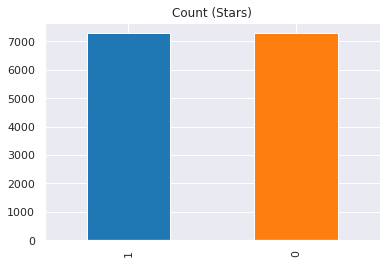

In [ ]:
# CONTAR as CLASSES
class_0, class_1 = toronto_3.stars.value_counts()

# Divide as classes
df_class_0 = toronto_3[toronto_3['stars'] == 0]
df_class_1 = toronto_3[toronto_3['stars'] == 1]
df_class_1_1 = df_class_1.sample(class_0, replace=True)
toronto_4 = pd.concat([df_class_0, df_class_1_1], axis=0)

print('Random over-sampling:')
print(toronto_4.stars.value_counts())
toronto_4.stars.value_counts().plot(kind='bar', title='Count (Stars)',color = ['#1F77B4', '#FF7F0E']);

### Importando a biblioteca do pycaret

In [ ]:
!pip install pycaret

shell-init: error retrieving current directory: getcwd: cannot access parent directories: No such file or directory
shell-init: error retrieving current directory: getcwd: cannot access parent directories: No such file or directory
The folder you are executing pip from can no longer be found.


In [ ]:
from pycaret.utils import enable_colab
enable_colab()


Colab mode enabled.


 ### Importando o Modelo de classifição

In [ ]:
from pycaret.classification import *

### Transformando os dados em binarios com labelEncoder

In [ ]:
from sklearn.preprocessing import LabelEncoder

In [ ]:
modelo = toronto_4.apply(LabelEncoder().fit_transform)

In [ ]:
modelo.head()

,latitude,longitude,stars,review_count,is_open,RestaurantsAttire,NoiseLevel,OutdoorSeating,GoodForKids,Caters,RestaurantsGoodForGroups,RestaurantsPriceRange2,RestaurantsTakeOut,Alcohol,RestaurantsDelivery,WiFi,BikeParking,RestaurantsReservations,HasTV,WheelchairAccessible,gmf_breakfast,gfm_brunch,gfm_dessert,gfm_dinner,gfm_latenight,gfm_lunch,bp_garage,bp_lot,bp_street,bp_valet,bp_validated
0,6129,1333,0,48,1,0,3,0,1,1,1,1,1,3,0,0,1,0,1,3,1,1,0,0,0,1,0,0,1,0,0
1,9084,8642,0,40,0,0,0,0,1,0,1,1,1,3,0,0,1,1,0,3,0,1,0,0,0,1,0,0,0,0,0
2,4316,2115,0,13,1,3,0,1,2,2,1,1,2,1,2,1,2,2,2,3,2911,1221,1334,1117,2605,1405,523,582,733,436,2
3,4455,2495,0,8,0,3,2,2,2,2,2,1,2,2,2,1,1,2,2,3,2910,1115,1331,1127,2619,1607,0,0,1,0,0
5,1220,4563,0,3,0,0,2,2,0,1,2,4,1,2,2,0,2,0,2,0,0,0,0,0,0,0,0,1,1,0,0


In [ ]:
modelo.info()

### Separando os dados em treino e teste e fazendo os tratamentos adequados como:
 *  Normalização;
 *  Tratamento dos dados faltantes;
 *  Tratamento dos Outliers;
 *  PCA;
 *  Feature Engineering etc

In [ ]:
model = setup(data= modelo, target = 'stars',  train_size= 0.8, session_id=786, imputation_type= 'simple', iterative_imputation_iters=5, normalize = True, normalize_method = 'zscore',
             ignore_low_variance = False, remove_multicollinearity = True, multicollinearity_threshold = 0.95,
              feature_selection = True, feature_selection_threshold= 0.9, feature_selection_method = 'classic',
               feature_interaction = True, feature_ratio = True, use_gpu = True, experiment_name= 'predicaoclassficacao',log_plots= True, combine_rare_levels= True, rare_level_threshold=0.5,
              remove_outliers = True, outliers_threshold = 0.5, fold_strategy='stratifiedkfold', fold=10, fold_shuffle=True, n_jobs= -1,
              pca = True, pca_method= 'linear')

,Description,Value
0,session_id,123
1,Target,stars
2,Target Type,Binary
3,Label Encoded,"0: 0, 1: 1"
4,Original Data,"(14570, 31)"
5,Missing Values,False
6,Numeric Features,14
7,Categorical Features,16
8,Ordinal Features,False
9,High Cardinality Features,False


INFO:logs:create_model_container: 0
INFO:logs:master_model_container: 0
INFO:logs:display_container: 1
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=True, features_todrop=[],
                                      id_columns=[],
                                      ml_usecase='classification',
                                      numerical_features=[], target='stars',
                                      time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value_categorical=None,
                                fill_value_numerical=None,
                                numeric_strate...
                                       target_variable='stars',
                                       threshold=0.95)),
                ('dfs',
                 DFS_Classic(

### Comparando os três melhores modelos

In [ ]:
top3 = compare_models(n_select = 3, fold=5, round=2, cross_validation= True)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.86,0.94,0.86,0.83,0.85,0.71,0.71,0.19
dt,Decision Tree Classifier,0.84,0.84,0.87,0.80,0.83,0.68,0.68,0.06
catboost,CatBoost Classifier,0.84,0.93,0.83,0.82,0.82,0.67,0.67,6.10
gbc,Gradient Boosting Classifier,0.80,0.90,0.77,0.79,0.78,0.60,0.60,1.37
ada,Ada Boost Classifier,0.77,0.87,0.77,0.74,0.76,0.54,0.54,0.44
lr,Logistic Regression,0.57,0.63,0.07,0.71,0.12,0.06,0.11,0.07
qda,Quadratic Discriminant Analysis,0.55,0.60,0.24,0.73,0.23,0.05,0.11,0.03
nb,Naive Bayes,0.54,0.63,0.22,0.68,0.19,0.02,0.07,0.02
ridge,Ridge Classifier,0.54,0.00,0.01,0.59,0.02,0.00,0.02,0.03
lda,Linear Discriminant Analysis,0.54,0.62,0.01,0.59,0.02,0.00,0.02,0.04


INFO:logs:create_model_container: 17
INFO:logs:master_model_container: 17
INFO:logs:display_container: 2
INFO:logs:[LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=123, reg_alpha=0.0, reg_lambda=0.0, silent=True,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0), DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=123, splitter='best')

In [ ]:
type(top3)

In [ ]:
print(top3)


### Criando os modelos

In [ ]:
rf = create_model('lightgbm', fold=10, cross_validation=True, round=2)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.84,0.93,0.87,0.79,0.83,0.67,0.67
1,0.84,0.93,0.82,0.82,0.82,0.67,0.67
2,0.87,0.95,0.88,0.83,0.86,0.73,0.73
3,0.87,0.95,0.85,0.86,0.85,0.73,0.73
4,0.89,0.96,0.90,0.86,0.88,0.78,0.78
5,0.85,0.94,0.86,0.82,0.84,0.69,0.69
6,0.86,0.94,0.88,0.82,0.85,0.71,0.71
7,0.85,0.94,0.83,0.85,0.84,0.70,0.70
8,0.85,0.95,0.87,0.82,0.84,0.71,0.71
9,0.87,0.95,0.87,0.85,0.86,0.74,0.74


INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 3
INFO:logs:LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=123, reg_alpha=0.0, reg_lambda=0.0, silent=True,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)
INFO:logs:create_model() succesfully completed......................................


In [ ]:
et = create_model('catboost', cross_validation=True, round=2)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.85,0.93,0.88,0.81,0.84,0.70,0.70
1,0.84,0.93,0.83,0.82,0.82,0.67,0.67
2,0.86,0.94,0.87,0.84,0.85,0.72,0.72
3,0.85,0.93,0.82,0.85,0.83,0.70,0.70
4,0.88,0.95,0.88,0.85,0.87,0.75,0.75
5,0.84,0.93,0.83,0.82,0.83,0.68,0.68
6,0.83,0.93,0.85,0.80,0.82,0.66,0.66
7,0.85,0.93,0.84,0.84,0.84,0.70,0.70
8,0.84,0.94,0.83,0.82,0.82,0.67,0.67
9,0.85,0.93,0.83,0.84,0.83,0.69,0.69


INFO:logs:create_model_container: 19
INFO:logs:master_model_container: 19
INFO:logs:display_container: 4
INFO:logs:<catboost.core.CatBoostClassifier object at 0x7f7ada22ca58>
INFO:logs:create_model() succesfully completed......................................


In [ ]:
dt = create_model('dt', cross_validation=True,   round=2)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.85,0.85,0.89,0.80,0.84,0.70,0.70
1,0.83,0.84,0.86,0.79,0.83,0.67,0.67
2,0.86,0.86,0.89,0.82,0.85,0.72,0.72
3,0.79,0.80,0.82,0.75,0.78,0.59,0.59
4,0.87,0.87,0.89,0.83,0.86,0.74,0.74
5,0.87,0.87,0.89,0.84,0.86,0.74,0.74
6,0.83,0.83,0.84,0.80,0.82,0.67,0.67
7,0.84,0.85,0.88,0.80,0.84,0.69,0.69
8,0.87,0.87,0.87,0.85,0.86,0.73,0.73
9,0.85,0.86,0.88,0.81,0.85,0.71,0.71


INFO:logs:create_model_container: 20
INFO:logs:master_model_container: 20
INFO:logs:display_container: 5
INFO:logs:DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=123, splitter='best')
INFO:logs:create_model() succesfully completed......................................


 ### Analise:
 * O modelo lightgbm teve uma performance um pouco  melhor

### Melhorando os Hiperpârametros

In [ ]:
rf_1 = tune_model(rf, fold=5, round=2, n_iter=20)

INFO:logs:Initializing tune_model()
INFO:logs:tune_model(kwargs={}, display=None, tuner_verbose=True, verbose=True, return_tuner=False, groups=None, fit_kwargs=None, choose_better=False, early_stopping_max_iters=10, early_stopping=False, search_algorithm=None, search_library=scikit-learn, custom_scorer=None, optimize=Accuracy, custom_grid=None, n_iter=20, round=2, fold=5, estimator=LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=123, reg_alpha=0.0, reg_lambda=0.0, silent=True,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0))
INFO:logs:Checking exceptions
INFO:logs:Preparing display monitor


IntProgress(value=0, description='Processing: ', max=7)

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,16:35:12
Status,. . . . . . . . . . . . . . . . . .,Searching Hyperparameters
Estimator,. . . . . . . . . . . . . . . . . .,Light Gradient Boosting Machine


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC


INFO:logs:Copying training dataset
INFO:logs:Checking base model
INFO:logs:Base model : Light Gradient Boosting Machine
INFO:logs:Declaring metric variables
INFO:logs:Defining Hyperparameters
INFO:logs:Tuning with n_jobs=-1
INFO:logs:Initializing RandomizedSearchCV


Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py", line 2882, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-199-7427d1c7eb03>", line 1, in <module>
    et_1 = tune_model(rf, fold=5, round=2, n_iter=20)
  File "/usr/local/lib/python3.6/dist-packages/pycaret/classification.py", line 1101, in tune_model
    **kwargs,
  File "/usr/local/lib/python3.6/dist-packages/pycaret/internal/tabular.py", line 4460, in tune_model_supervised
    model_grid.fit(X_train, y_train, groups=groups, **fit_kwargs)
  File "/usr/local/lib/python3.6/dist-packages/sklearn/utils/validation.py", line 72, in inner_f
    return f(**kwargs)
  File "/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_search.py", line 736, in fit
    self._run_search(evaluate_candidates)
  File "/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_search.py", line 1531, in _run_search
    random_state=self.r

FileNotFoundError: ignored

In [ ]:
et_1 = tune_model(et, fold=5, round=2, n_iter=20)

In [ ]:
dt_1 = tune_model(dt, fold=5, round=2, n_iter=20)

INFO:logs:Initializing tune_model()
INFO:logs:tune_model(kwargs={}, display=None, tuner_verbose=True, verbose=True, return_tuner=False, groups=None, fit_kwargs=None, choose_better=False, early_stopping_max_iters=10, early_stopping=False, search_algorithm=None, search_library=scikit-learn, custom_scorer=None, optimize=Accuracy, custom_grid=None, n_iter=20, round=2, fold=5, estimator=DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=123, splitter='best'))
INFO:logs:Checking exceptions
INFO:logs:Preparing display monitor


IntProgress(value=0, description='Processing: ', max=7)

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,16:36:30
Status,. . . . . . . . . . . . . . . . . .,Searching Hyperparameters
Estimator,. . . . . . . . . . . . . . . . . .,Decision Tree Classifier


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC


INFO:logs:Copying training dataset
INFO:logs:Checking base model
INFO:logs:Base model : Decision Tree Classifier
INFO:logs:Declaring metric variables
INFO:logs:Defining Hyperparameters
INFO:logs:Tuning with n_jobs=-1
INFO:logs:Initializing RandomizedSearchCV


Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py", line 2882, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-200-18c8b91118c7>", line 1, in <module>
    dt_1 = tune_model(dt, fold=5, round=2, n_iter=20)
  File "/usr/local/lib/python3.6/dist-packages/pycaret/classification.py", line 1101, in tune_model
    **kwargs,
  File "/usr/local/lib/python3.6/dist-packages/pycaret/internal/tabular.py", line 4460, in tune_model_supervised
    model_grid.fit(X_train, y_train, groups=groups, **fit_kwargs)
  File "/usr/local/lib/python3.6/dist-packages/sklearn/utils/validation.py", line 72, in inner_f
    return f(**kwargs)
  File "/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_search.py", line 736, in fit
    self._run_search(evaluate_candidates)
  File "/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_search.py", line 1531, in _run_search
    random_state=self.r

FileNotFoundError: ignored

#### Analise:
* Os ajustes dos hiperparametros  nao melhorou em nada os modelos


### Aplicando ensemble 
  Para tentar melhorar a performance
`



In [ ]:
rf_en = ensemble_model(rf, fold=5, method='Bagging',n_estimators = 20, round=2)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.84,0.93,0.87,0.79,0.83,0.67,0.68
1,0.87,0.94,0.88,0.84,0.86,0.73,0.73
2,0.86,0.94,0.87,0.82,0.85,0.71,0.71
3,0.85,0.94,0.88,0.81,0.84,0.70,0.70
4,0.85,0.94,0.85,0.84,0.84,0.71,0.71
Mean,0.85,0.94,0.87,0.82,0.84,0.70,0.71
SD,0.01,0.00,0.01,0.02,0.01,0.02,0.02


INFO:logs:create_model_container: 21
INFO:logs:master_model_container: 21
INFO:logs:display_container: 6
INFO:logs:BaggingClassifier(base_estimator=LGBMClassifier(boosting_type='gbdt',
                                                class_weight=None,
                                                colsample_bytree=1.0,
                                                importance_type='split',
                                                learning_rate=0.1, max_depth=-1,
                                                min_child_samples=20,
                                                min_child_weight=0.001,
                                                min_split_gain=0.0,
                                                n_estimators=100, n_jobs=-1,
                                                num_leaves=31, objective=None,
                                                random_state=123, reg_alpha=0.0,
                                                reg_lambda=0.0, silent=True,


In [ ]:
et_en = ensemble_model(et, fold=5, method='Bagging', n_estimators = 20, round=2)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.83,0.92,0.85,0.79,0.82,0.65,0.65
1,0.85,0.93,0.84,0.83,0.84,0.70,0.70
2,0.84,0.93,0.83,0.81,0.82,0.67,0.67
3,0.83,0.92,0.83,0.80,0.82,0.66,0.66
4,0.82,0.92,0.81,0.80,0.81,0.64,0.64
Mean,0.83,0.92,0.83,0.81,0.82,0.66,0.66
SD,0.01,0.00,0.01,0.01,0.01,0.02,0.02


INFO:logs:create_model_container: 22
INFO:logs:master_model_container: 22
INFO:logs:display_container: 7
INFO:logs:BaggingClassifier(base_estimator=<catboost.core.CatBoostClassifier object at 0x7f7aa677e278>,
                  bootstrap=True, bootstrap_features=False, max_features=1.0,
                  max_samples=1.0, n_estimators=20, n_jobs=1, oob_score=False,
                  random_state=123, verbose=0, warm_start=False)
INFO:logs:ensemble_model() succesfully completed......................................


In [ ]:
dt_en = ensemble_model(dt, fold=5, method='Bagging', n_estimators = 100, round=2)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.86,0.95,0.89,0.82,0.85,0.72,0.72
1,0.89,0.96,0.90,0.86,0.88,0.78,0.78
2,0.89,0.96,0.92,0.84,0.88,0.77,0.77
3,0.87,0.95,0.90,0.83,0.87,0.74,0.75
4,0.87,0.96,0.88,0.85,0.86,0.74,0.74
Mean,0.88,0.96,0.90,0.84,0.87,0.75,0.75
SD,0.01,0.01,0.01,0.01,0.01,0.02,0.02


INFO:logs:create_model_container: 23
INFO:logs:master_model_container: 23
INFO:logs:display_container: 8
INFO:logs:BaggingClassifier(base_estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                        class_weight=None,
                                                        criterion='gini',
                                                        max_depth=None,
                                                        max_features=None,
                                                        max_leaf_nodes=None,
                                                        min_impurity_decrease=0.0,
                                                        min_impurity_split=None,
                                                        min_samples_leaf=1,
                                                        min_samples_split=2,
                                                        min_weight_fraction_leaf=0.0,
                                      

* Blending
<p>
Ele cria vários modelos e, em seguida calcula a média das previsões individuais para formar uma previsão final</p>

In [ ]:
blender = blend_models(estimator_list = [rf, dt, et], round=2)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.87,0.94,0.93,0.81,0.87,0.74,0.75
1,0.85,0.94,0.88,0.81,0.84,0.70,0.71
2,0.88,0.95,0.92,0.84,0.88,0.77,0.77
3,0.83,0.93,0.85,0.79,0.82,0.66,0.66
4,0.89,0.96,0.93,0.85,0.89,0.79,0.79
5,0.88,0.96,0.89,0.85,0.87,0.76,0.76
6,0.87,0.94,0.90,0.83,0.86,0.74,0.74
7,0.86,0.94,0.89,0.82,0.86,0.73,0.73
8,0.89,0.95,0.91,0.86,0.88,0.78,0.78
9,0.87,0.95,0.89,0.84,0.87,0.75,0.75


INFO:logs:create_model_container: 24
INFO:logs:master_model_container: 24
INFO:logs:display_container: 9
INFO:logs:TunableVotingClassifier(estimators=[('lightgbm',
                                     LGBMClassifier(boosting_type='gbdt',
                                                    class_weight=None,
                                                    colsample_bytree=1.0,
                                                    importance_type='split',
                                                    learning_rate=0.1,
                                                    max_depth=-1,
                                                    min_child_samples=20,
                                                    min_child_weight=0.001,
                                                    min_split_gain=0.0,
                                                    n_estimators=100, n_jobs=-1,
                                                    num_leaves=31,
                                 

### Analise:
* Nao melherou em nada tambem a performance do modelo. Vamos seguir sem os ajustes

### Analisando  a performance



In [ ]:
evaluate_model(rf)

INFO:logs:Initializing evaluate_model()
INFO:logs:evaluate_model(use_train_data=False, groups=None, feature_name=None, fit_kwargs=None, fold=None, estimator=LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=123, reg_alpha=0.0, reg_lambda=0.0, silent=True,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0))


interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [ ]:
evaluate_model(blender)

INFO:logs:Initializing evaluate_model()
INFO:logs:evaluate_model(use_train_data=False, groups=None, feature_name=None, fit_kwargs=None, fold=None, estimator=TunableVotingClassifier(estimators=[('lightgbm',
                                     LGBMClassifier(boosting_type='gbdt',
                                                    class_weight=None,
                                                    colsample_bytree=1.0,
                                                    importance_type='split',
                                                    learning_rate=0.1,
                                                    max_depth=-1,
                                                    min_child_samples=20,
                                                    min_child_weight=0.001,
                                                    min_split_gain=0.0,
                                                    n_estimators=100, n_jobs=-1,
                                                    num_le

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

### Finalizando o modelo

      Criando o modelo final com blending

In [ ]:
final_blender = finalize_model(blender)

INFO:logs:Initializing finalize_model()
INFO:logs:finalize_model(display=None, model_only=True, groups=None, fit_kwargs=None, estimator=TunableVotingClassifier(estimators=[('lightgbm',
                                     LGBMClassifier(boosting_type='gbdt',
                                                    class_weight=None,
                                                    colsample_bytree=1.0,
                                                    importance_type='split',
                                                    learning_rate=0.1,
                                                    max_depth=-1,
                                                    min_child_samples=20,
                                                    min_child_weight=0.001,
                                                    min_split_gain=0.0,
                                                    n_estimators=100, n_jobs=-1,
                                                    num_leaves=31,
            

### Predição do modelo

In [ ]:
predicao_blender = predict_model(final_blender)
predicao_blender.head()

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(display=None, ml_usecase=MLUsecase.CLASSIFICATION, verbose=True, round=4, encoded_labels=False, probability_threshold=None, estimator=TunableVotingClassifier(estimators=[('lightgbm',
                                     LGBMClassifier(boosting_type='gbdt',
                                                    class_weight=None,
                                                    colsample_bytree=1.0,
                                                    importance_type='split',
                                                    learning_rate=0.1,
                                                    max_depth=-1,
                                                    min_child_samples=20,
                                                    min_child_weight=0.001,
                                                    min_split_gain=0.0,
                                                    n_estimators=100, n_jobs=-1,
                  

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Voting Classifier,0.9938,0.9999,0.9912,0.9966,0.9939,0.9876,0.9877


,Component_1,Component_2,Component_3,Component_4,Component_5,Component_6,Component_7,Component_8,Component_9,stars,Label,Score
0,-2.148569,-1.064519,-1.383227,1.412717,-2.190161,-3.807744,0.661571,-1.514575,1.295763,0,0,0.8585
1,-1.597550,0.999057,-0.011676,3.866772,0.500351,0.366202,5.349193,-0.056318,-0.421408,0,0,0.7281
2,-1.579990,-2.364152,-0.224924,-5.608557,-0.224937,0.186024,3.488069,-0.080960,-0.461180,0,0,0.7842
3,-1.990155,-3.157328,-1.078958,2.605713,-1.944782,-7.649353,-0.351098,-1.270596,2.141358,0,0,0.9221
4,-1.578260,-2.040536,-1.336889,1.322895,0.299879,0.338574,2.446518,-0.060860,-0.428466,0,0,0.7376


### Analise:
 


### Salvando o modelo Para colocar em produção
    

---



In [ ]:
save_model(predicao_blender,'Predição da nota estabelecimento')

INFO:logs:Initializing save_model()
INFO:logs:save_model(verbose=True, prep_pipe_=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=True, features_todrop=[],
                                      id_columns=[],
                                      ml_usecase='classification',
                                      numerical_features=[], target='stars',
                                      time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value_categorical=None,
                                fill_value_numerical=None,
                                numeric_strate...
                                       target_variable='stars',
                                       threshold=0.95)),
                ('dfs',
                 DFS_Classic(interactions=['multiply', 'divi

Transformation Pipeline and Model Succesfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=True, features_todrop=[],
                                       id_columns=[],
                                       ml_usecase='classification',
                                       numerical_features=[], target='stars',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='not_available',
                                 fill_value_categorical=None,
                                 fill_value_numerical=None,
                                 numeric_strate...
 2       -1.579990    -2.364152    -0.224924  ...      0      0  0.7842
 3       -1.990155    -3.157328    -1.078958  ...      0      0  0.9221
 4       -1.578260    -2.040536    -1.336889  ...      0      0  0.7376
 ...           ...          ...          ...  ...    ...  

### Carregando o Modelo Salvo

In [ ]:
salvando_modelo = load_model('Predição da nota estabelecimento')

### Salvando minhas métricas em MLFLOW
<p>

MLflow é uma plataforma de código aberto para gerenciar o ciclo de vida de ML, incluindo experimentação, reprodutibilidade, implantação e um registro de modelo central. O MLflow oferece atualmente quatro componentes
</p>

In [ ]:
!pip install mlflow --quiet
!pip install pyngrok --quiet

import mlflow

with mlflow.start_run(run_name="MLflow on Colab"):
  mlflow.log_metric("m1", 2.0)
  mlflow.log_param("p1", "mlflow-colab")


get_ipython().system_raw("mlflow ui --port 5000 &") 




from pyngrok import ngrok


ngrok.kill()


NGROK_AUTH_TOKEN = ""
ngrok.set_auth_token(NGROK_AUTH_TOKEN)

# tunnel on port 5000 for http://localhost:5000
ngrok_tunnel = ngrok.connect(addr="5000", proto="http", bind_tls=True)
print("MLflow Tracking UI:", ngrok_tunnel.public_url)

In [ ]:
!pip install streamlit 
!pip install pyngrok
!pip install pycaret

In [ ]:
#Importando as bibliotecas necessárias 
from pycaret.classification import load_model, predict_model
import streamlit as st
import pandas as pd
import numpy as np
import joblib



In [ ]:

%%writefile app.py
import streamlit as st
from PIL import Image
PAGE_CONFIG = {"page_title":"StColab.io","page_icon":":smiley:","layout":"centered"}
st.beta_set_page_config(**PAGE_CONFIG)


def predict_quality(model, df):
    predictions_data = predict_model(estimator = model, data = df)
    return predictions_data['Label'][0]

model = load_model('Predição da nota estabelecimento')

# Add titulo, imagem e uma pequena descrição do nosso projeto
st.title('Predizendo a avaliação do estabelecimento')
st.write('Este aplicativo busca ajudar os estabelecimentos a identificar pontos de melhorias para atrairem mais clientes, através de uma boa avaliação.')
image = "https://agoraentert.com.br/wp-content/uploads/2016/11/imagem.png"
st.image(image, use_column_width=True)
st.write('Por favor preencha as informações solicitadas ao lado, de acordo a qual o estabelecimento possui e clique no botão abaixo!')

Tipo_Restaurante = st.sidebar.write("Tipo de Restaurante", 'casual', 'dressy', 'formal')
NoiseLevel =      st.sidebar.write("O Ambiente é", 'average', 'quiet','loud', 'very_loud')
bp_street =       st.sidebar.write("Estacionamento na rua", 'sim', 'não')
hasTV =          st.sidebar.write("Possui TV no local", 'sim', 'não')
Wifi =           st.sidebar.write("Possui Wifi no local", 'sim', 'não')

features = {'RestaurantsAttire': Tipo_Restaurante, 'NoiseLevel': NoiseLevel,
            'bp_street': bp_street, 'hasTV': hasTV, 'Wifi': Wifi
            }
 

features_df  = pd.DataFrame([features])

st.table(features_df)  

if st.button('Predict'):
    
    prediction = predict_quality(model, features_df)
    
    st.write(' Com base nas informações sua avalição é '+ str(prediction))

if __name__ == '__predict_quality__':
	predict_quality()


In [ ]:
# ngrok auth config
!ngrok authtoken 1nDVHNO3h6pI4HZkXtox2OFoQ1Z_355ocSrxb4w6CfN7f2Dqx

In [ ]:
from pyngrok import ngrok


In [ ]:
!streamlit run app.py &>/dev/null&

In [ ]:
# Verificando se está  rodando
!pgrep streamlit

In [ ]:
get_ipython().system_raw('./ngrok http 8501 &')
! curl -s http://localhost:4040/api/tunnels | python3 -c \
    "import sys, json; print(json.load(sys.stdin)['tunnels'][0]['public_url'])"

In [ ]:
#Setup  streamlit na porta 8501
public_url = ngrok.connect(port='8501')
